# Лабораторная работа №5

### ФИО: Селина Елизавета Александровна
### Группа: БИВТ-23-СП-2

#### Импорты библиотек и настройка окружения

Подключаем необходимые библиотеки для работы с изображениями, нейронными сетями,
визуализацией и вычисления метрик качества.

In [23]:
import os
import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from PIL import Image
from collections import Counter

import torch
import torch.nn as nn
from torch.utils.data import DataLoader
from torchvision import datasets, transforms, models

from sklearn.metrics import (
    accuracy_score,
    precision_score,
    recall_score,
    f1_score,
    confusion_matrix,
    ConfusionMatrixDisplay
)

# Фиксируем seed для воспроизводимости
SEED = 42
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
torch.cuda.manual_seed_all(SEED)

device = torch.device("cuda" if torch.cuda.is_available() else "mps")
device

device(type='mps')

## 1. Загрузка данных

Используем датасет Intel Image Classification.
Данные представлены в виде изображений, разложенных по папкам,
где имя папки соответствует классу.
seg_train/
    buildings/
    forest/
    glacier/
    mountain/
    sea/
    street/

In [24]:
import os
import shutil
from pathlib import Path
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
from collections import Counter
import warnings
warnings.filterwarnings('ignore')

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torchvision import datasets, transforms, models


device = torch.device('cuda' if torch.cuda.is_available() else 'mps')
print(f'Используемое устройство: {device}')

SEED = 42
torch.manual_seed(SEED)
np.random.seed(SEED)
if torch.cuda.is_available():
    torch.cuda.manual_seed(SEED)

DATA_DIR = './dataset'
TRAIN_DIR = os.path.join(DATA_DIR, 'seg_train/seg_train')
TEST_DIR = os.path.join(DATA_DIR, 'seg_test/seg_test')
PRED_DIR = os.path.join(DATA_DIR, 'seg_pred/seg_pred')


classes = sorted(os.listdir(TRAIN_DIR))
print(f"\nКлассы ({len(classes)}): {classes}")


Используемое устройство: mps

Классы (6): ['buildings', 'forest', 'glacier', 'mountain', 'sea', 'street']


## 2. Постановка задачи

Перед нами задача многоклассовой классификации изображений.

Цель: по изображению определить тип сцены.

Классы:
- forest
- buildings
- glacier
- street
- mountain
- sea

Тип задачи:
- многоклассовая классификация
- количество классов: 6
- функция потерь: CrossEntropyLoss

Пример реального применения:
- автоматическая классификация фотографий
- анализ спутниковых снимков
- навигационные и картографические системы

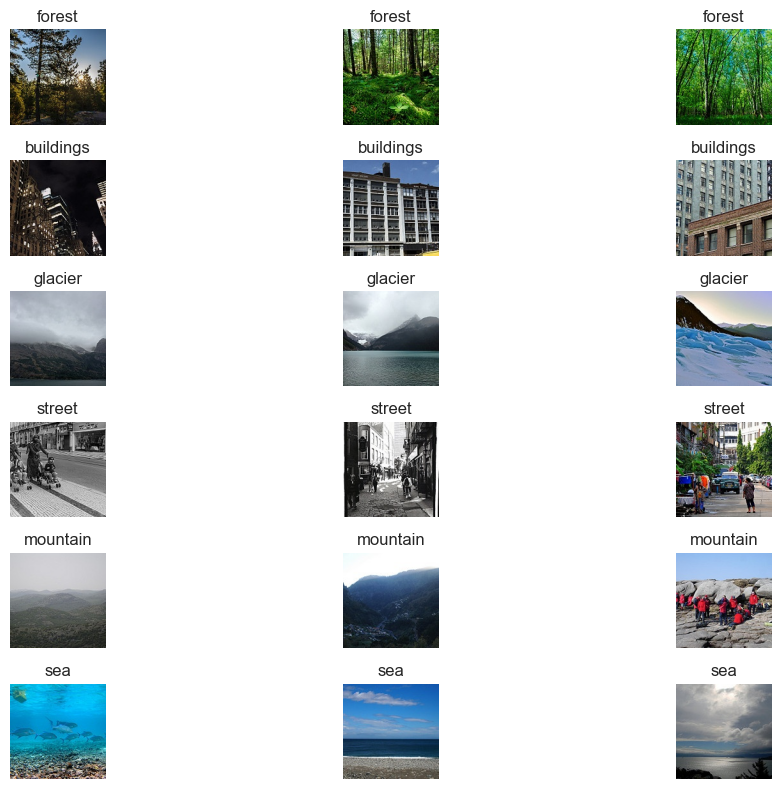

In [25]:
#Покажем примеры изображений
def show_images_per_class(data_dir, n_images=3):
    classes = os.listdir(data_dir)
    plt.figure(figsize=(12, 8))
    
    idx = 1
    for cls in classes:
        cls_path = os.path.join(data_dir, cls)
        images = os.listdir(cls_path)[:n_images]
        
        for img_name in images:
            img_path = os.path.join(cls_path, img_name)
            img = Image.open(img_path)
            
            plt.subplot(len(classes), n_images, idx)
            plt.imshow(img)
            plt.axis("off")
            plt.title(cls)
            idx += 1
    
    plt.tight_layout()
    plt.show()

show_images_per_class(TRAIN_DIR)

## 3. Предобработка данных

### 3.1 Проверка изображений и приведение к единому размеру

Перед обучением модели необходимо убедиться, что все изображения корректно читаются и не повреждены. 

In [26]:
def check_corrupted_images(data_dir):
    """Проверка изображений на повреждения"""
    corrupted = []
    total = 0

    if not os.path.exists(data_dir):
        print(f"Директория {data_dir} не найдена")
        return corrupted

    for class_name in os.listdir(data_dir):
        class_path = os.path.join(data_dir, class_name)
        if not os.path.isdir(class_path):
            continue

        for img_name in os.listdir(class_path):
            if not img_name.endswith(('.jpg', '.jpeg', '.png')):
                continue

            total += 1
            img_path = os.path.join(class_path, img_name)

            try:
                with Image.open(img_path) as img:
                    img.verify()  # Проверка целостности
                # Повторно открываем для проверки загрузки
                with Image.open(img_path) as img:
                    img.load()
            except Exception as e:
                corrupted.append((img_path, str(e)))

    return corrupted, total

# Проверяем обучающую выборку
print("Проверка изображений на повреждения...\n")
corrupted_train, total_train = check_corrupted_images(TRAIN_DIR)
corrupted_test, total_test = check_corrupted_images(TEST_DIR)

print(f"TRAIN: проверено {total_train} изображений")
if corrupted_train:
    print(f" Повреждённых: {len(corrupted_train)}")
    for path, error in corrupted_train[:5]:
        print(f"    - {path}: {error}")
else:
    print(" Все изображения корректны")

print(f"\nTEST: проверено {total_test} изображений")
if corrupted_test:
    print(f"Повреждённых: {len(corrupted_test)}")
    for path, error in corrupted_test[:5]:
        print(f"    - {path}: {error}")
else:
    print("  Все изображения корректны")


Проверка изображений на повреждения...

TRAIN: проверено 14034 изображений
 Все изображения корректны

TEST: проверено 3000 изображений
  Все изображения корректны


### 3.2 Нормализация изображений

Изображения приводятся к размеру 224×224. Далее применяется нормализация по каналам RGB с использованием статистик ImageNet, так как используется transfer learning.

Анализ размеров изображений (выборка из 500 изображений):

Ширина:  min=150, max=150, mean=150.0
Высота:  min=108, max=150, mean=149.8

Уникальных размеров: 4
Размеры: [(150, 108), (150, 115), (150, 150), (150, 136)]


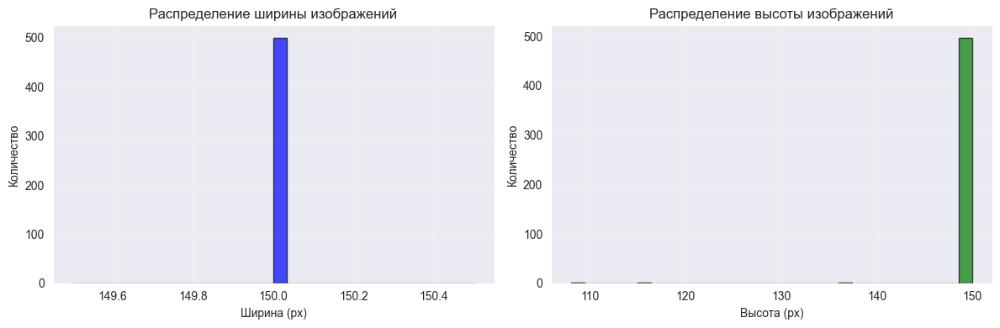

In [27]:
def analyze_image_sizes(data_dir, sample_size=500):
    """Анализ размеров изображений в датасете"""
    sizes = []

    if not os.path.exists(data_dir):
        return sizes

    count = 0
    for class_name in os.listdir(data_dir):
        class_path = os.path.join(data_dir, class_name)
        if not os.path.isdir(class_path):
            continue

        for img_name in os.listdir(class_path):
            if not img_name.endswith(('.jpg', '.jpeg', '.png')):
                continue

            if count >= sample_size:
                break

            img_path = os.path.join(class_path, img_name)
            try:
                with Image.open(img_path) as img:
                    sizes.append((img.width, img.height))
                count += 1
            except:
                pass

        if count >= sample_size:
            break

    return sizes

# Анализируем размеры
sizes = analyze_image_sizes(TRAIN_DIR, sample_size=500)

if sizes:
    widths = [s[0] for s in sizes]
    heights = [s[1] for s in sizes]

    print(f"Анализ размеров изображений (выборка из {len(sizes)} изображений):\n")
    print(f"Ширина:  min={min(widths)}, max={max(widths)}, mean={np.mean(widths):.1f}")
    print(f"Высота:  min={min(heights)}, max={max(heights)}, mean={np.mean(heights):.1f}")

    unique_sizes = list(set(sizes))
    print(f"\nУникальных размеров: {len(unique_sizes)}")

    if len(unique_sizes) <= 5:
        print("Размеры:", unique_sizes)

    # Визуализация
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))

    ax1.hist(widths, bins=30, alpha=0.7, color='blue', edgecolor='black')
    ax1.set_xlabel('Ширина (px)')
    ax1.set_ylabel('Количество')
    ax1.set_title('Распределение ширины изображений')
    ax1.grid(alpha=0.3)

    ax2.hist(heights, bins=30, alpha=0.7, color='green', edgecolor='black')
    ax2.set_xlabel('Высота (px)')
    ax2.set_ylabel('Количество')
    ax2.set_title('Распределение высоты изображений')
    ax2.grid(alpha=0.3)

    plt.tight_layout()
    plt.show()
else:
    print("Не удалось проанализировать размеры изображений")


### 3.3 Разделение данных

Датасет уже разделён на обучающую и валидационную выборки (seg_train и seg_test), поэтому дополнительного разбиения не требуется.

In [28]:
# Константы для предобработки
IMG_SIZE = 224
BATCH_SIZE = 32
NUM_WORKERS = 4

# Статистики ImageNet для нормализации
IMAGENET_MEAN = [0.485, 0.456, 0.406]
IMAGENET_STD = [0.229, 0.224, 0.225]

print(f"Параметры предобработки:")
print(f"  Размер изображений: {IMG_SIZE}×{IMG_SIZE}")
print(f"  Batch size: {BATCH_SIZE}")
print(f"  Нормализация: ImageNet (mean={IMAGENET_MEAN}, std={IMAGENET_STD})")


Параметры предобработки:
  Размер изображений: 224×224
  Batch size: 32
  Нормализация: ImageNet (mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])


### 3.4 Формирование Dataset и DataLoader

Для загрузки изображений используется ImageFolder, который автоматически сопоставляет изображения с классами по названиям папок.

In [29]:
transform_test = transforms.Compose([
    transforms.Resize((IMG_SIZE, IMG_SIZE)),
    transforms.ToTensor(),
    transforms.Normalize(mean=IMAGENET_MEAN, std=IMAGENET_STD)
])


transform_train_base = transforms.Compose([
    transforms.Resize((IMG_SIZE, IMG_SIZE)),
    transforms.ToTensor(),
    transforms.Normalize(mean=IMAGENET_MEAN, std=IMAGENET_STD)
])

print("Трансформации настроены")


Трансформации настроены


# 3.5 DataLoader

In [30]:
# Создаём Dataset
if os.path.exists(TRAIN_DIR) and os.path.exists(TEST_DIR):
    train_dataset_base = datasets.ImageFolder(root=TRAIN_DIR, transform=transform_train_base)
    test_dataset = datasets.ImageFolder(root=TEST_DIR, transform=transform_test)

    # Создаём DataLoader
    train_loader_base = DataLoader(
        train_dataset_base,
        batch_size=BATCH_SIZE,
        shuffle=True,
        num_workers=NUM_WORKERS,
        pin_memory=True if torch.cuda.is_available() else False
    )

    test_loader = DataLoader(
        test_dataset,
        batch_size=BATCH_SIZE,
        shuffle=False,
        num_workers=NUM_WORKERS,
        pin_memory=True if torch.cuda.is_available() else False
    )

    # Информация о датасете
    class_names = train_dataset_base.classes
    num_classes = len(class_names)

    print("Датасеты созданы:\n")
    print(f"Train dataset:")
    print(f"  Изображений: {len(train_dataset_base)}")
    print(f"  Батчей: {len(train_loader_base)}")

    print(f"\nTest dataset:")
    print(f"  Изображений: {len(test_dataset)}")
    print(f"  Батчей: {len(test_loader)}")

    print(f"\nКлассы ({num_classes}):")
    for idx, name in enumerate(class_names):
        print(f"  {idx}: {name}")
else:
    print("Директории с данными не найдены!")


Датасеты созданы:

Train dataset:
  Изображений: 14034
  Батчей: 439

Test dataset:
  Изображений: 3000
  Батчей: 94

Классы (6):
  0: buildings
  1: forest
  2: glacier
  3: mountain
  4: sea
  5: street


# 3.6 Визуализация batch

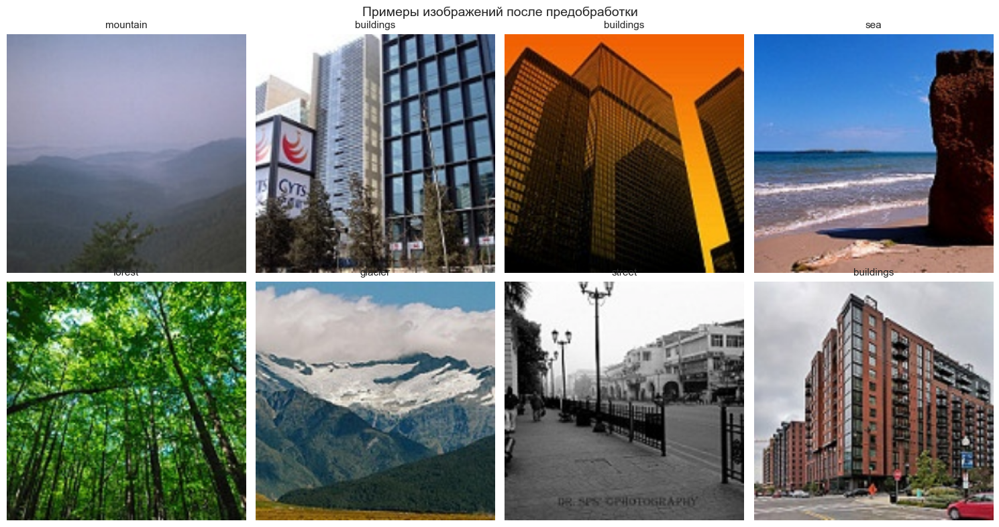

In [31]:
# Функция для денормализации изображений
def denormalize(tensor, mean=IMAGENET_MEAN, std=IMAGENET_STD):
    """Денормализация тензора для визуализации"""
    mean = torch.tensor(mean).view(3, 1, 1)
    std = torch.tensor(std).view(3, 1, 1)
    return tensor * std + mean

# Визуализация batch
def show_batch(loader, class_names, num_images=8):
    """Отображение изображений из batch"""
    # Получаем один batch
    images, labels = next(iter(loader))

    # Ограничиваем количество изображений
    num_images = min(num_images, len(images))

    fig, axes = plt.subplots(2, 4, figsize=(15, 8))
    axes = axes.flatten()

    for idx in range(num_images):
        img = denormalize(images[idx]).numpy().transpose(1, 2, 0)
        img = np.clip(img, 0, 1)  # Обрезаем значения в диапазон [0, 1]

        label = labels[idx].item()
        class_name = class_names[label]

        axes[idx].imshow(img)
        axes[idx].set_title(f'{class_name}', fontsize=11)
        axes[idx].axis('off')

    plt.suptitle('Примеры изображений после предобработки', fontsize=14, y=0.98)
    plt.tight_layout()
    plt.show()

# Показываем примеры
if 'train_loader_base' in dir():
    show_batch(train_loader_base, class_names, num_images=8)
else:
    print("DataLoader не создан")


## 4. Разведочный анализ данных (EDA)

### 4.1 Подсчёт количества изображений в каждом классе

На данном этапе определим количество изображений в каждом классе
и оценим, присутствует ли дисбаланс данных.

In [32]:
# Подсчитываем распределение классов
train_class_counts = {}
test_class_counts = {}

# Train
for class_idx, class_name in enumerate(class_names):
    count = sum(1 for label in train_dataset_base.targets if label == class_idx)
    train_class_counts[class_name] = count

# Test
for class_idx, class_name in enumerate(class_names):
    count = sum(1 for label in test_dataset.targets if label == class_idx)
    test_class_counts[class_name] = count

# Выводим статистику
print("Распределение классов:\n")
print(f"{'Класс':<15} {'Train':<10} {'Test':<10}")

for class_name in class_names:
    train_count = train_class_counts[class_name]
    test_count = test_class_counts[class_name]
    print(f"{class_name:<15} {train_count:<10} {test_count:<10}")

print("=" * 50)
print(f"{'ВСЕГО':<15} {sum(train_class_counts.values()):<10} {sum(test_class_counts.values()):<10}")

# Проверка на дисбаланс
train_counts_list = list(train_class_counts.values())
balance_ratio = max(train_counts_list) / min(train_counts_list)
print(f"\nКоэффициент дисбаланса (train): {balance_ratio:.2f}")
if balance_ratio < 1.5:
    print("Датасет сбалансирован")
elif balance_ratio < 3:
    print(" Умеренный дисбаланс")
else:
    print("Сильный дисбаланс - рекомендуется использовать class weights")


Распределение классов:

Класс           Train      Test      
buildings       2191       437       
forest          2271       474       
glacier         2404       553       
mountain        2512       525       
sea             2274       510       
street          2382       501       
ВСЕГО           14034      3000      

Коэффициент дисбаланса (train): 1.15
Датасет сбалансирован


### 4.2 Визуализация распределения классов

Построим bar chart для наглядного анализа распределения изображений по классам.

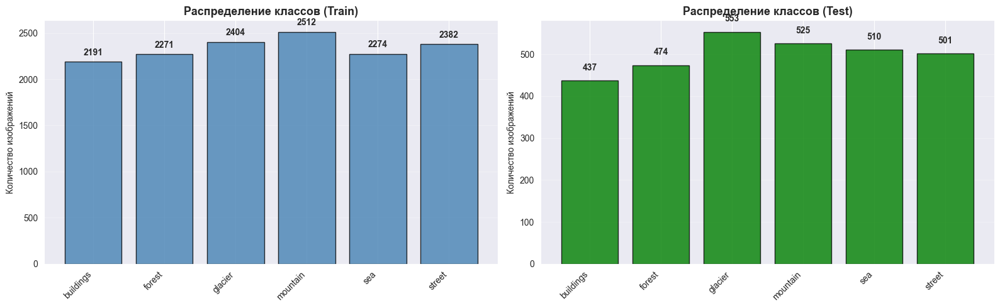

In [33]:
# Визуализация распределения классов
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 5))

# Train
classes_sorted = sorted(train_class_counts.keys())
train_values = [train_class_counts[c] for c in classes_sorted]

ax1.bar(range(len(classes_sorted)), train_values, color='steelblue', edgecolor='black', alpha=0.8)
ax1.set_xticks(range(len(classes_sorted)))
ax1.set_xticklabels(classes_sorted, rotation=45, ha='right')
ax1.set_ylabel('Количество изображений')
ax1.set_title('Распределение классов (Train)', fontsize=13, fontweight='bold')
ax1.grid(axis='y', alpha=0.3)

# Добавляем значения на столбцы
for i, v in enumerate(train_values):
    ax1.text(i, v + 50, str(v), ha='center', va='bottom', fontweight='bold')

# Test
test_values = [test_class_counts[c] for c in classes_sorted]

ax2.bar(range(len(classes_sorted)), test_values, color='green', edgecolor='black', alpha=0.8)
ax2.set_xticks(range(len(classes_sorted)))
ax2.set_xticklabels(classes_sorted, rotation=45, ha='right')
ax2.set_ylabel('Количество изображений')
ax2.set_title('Распределение классов (Test)', fontsize=13, fontweight='bold')
ax2.grid(axis='y', alpha=0.3)

# Добавляем значения на столбцы
for i, v in enumerate(test_values):
    ax2.text(i, v + 20, str(v), ha='center', va='bottom', fontweight='bold')

plt.tight_layout()
plt.show()


### 4.3 Промежуточные выводы по EDA

- Распределение классов в обучающей выборке является относительно сбалансированным.
- Явно выраженных редких классов не наблюдается.
- Существенного дисбаланса, требующего взвешивания классов или oversampling, нет.
- Классы визуально отличаются друг от друга, однако возможны пересечения (например, mountain и glacier, sea и coast), что может усложнять классификацию.
- Данные подходят для обучения модели многоклассовой классификации без
  дополнительной коррекции баланса.

Процентное соотношение классов:

Класс           Train %      Test %      
buildings        15.61%      14.57%
forest           16.18%      15.80%
glacier          17.13%      18.43%
mountain         17.90%      17.50%
sea              16.20%      17.00%
street           16.97%      16.70%


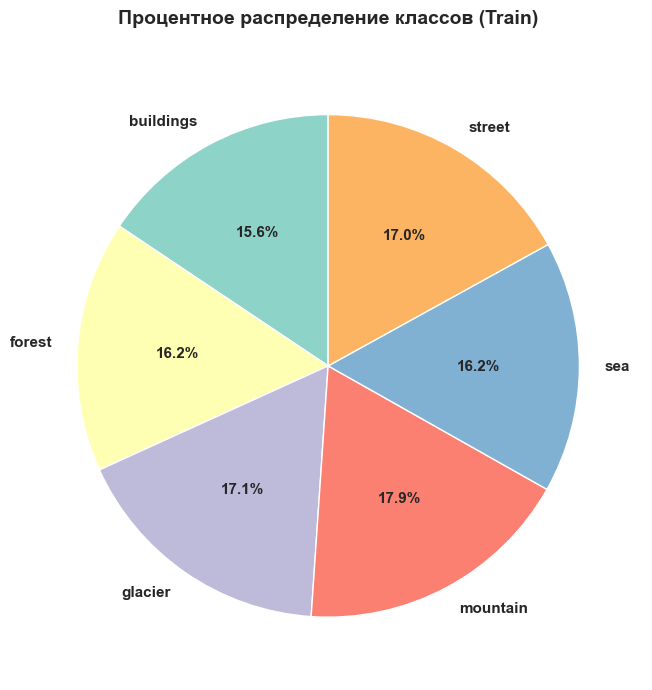

In [34]:
# Процентное соотношение классов
total_train = sum(train_class_counts.values())
total_test = sum(test_class_counts.values())

print("Процентное соотношение классов:\n")
print("=" * 55)
print(f"{'Класс':<15} {'Train %':<12} {'Test %':<12}")
print("=" * 55)

for class_name in classes_sorted:
    train_pct = (train_class_counts[class_name] / total_train) * 100
    test_pct = (test_class_counts[class_name] / total_test) * 100
    print(f"{class_name:<15} {train_pct:>6.2f}%     {test_pct:>6.2f}%")

print("=" * 55)

# Круговая диаграмма для train
fig, ax = plt.subplots(1, 1, figsize=(10, 7))
colors = plt.cm.Set3(range(len(classes_sorted)))

wedges, texts, autotexts = ax.pie(
    train_values,
    labels=classes_sorted,
    autopct='%1.1f%%',
    colors=colors,
    startangle=90,
    textprops={'fontsize': 11, 'fontweight': 'bold'}
)

ax.set_title('Процентное распределение классов (Train)', fontsize=14, fontweight='bold', pad=20)
plt.tight_layout()
plt.show()


## 5. Аугментация данных

Аугментация данных используется для искусственного увеличения обучающей выборки и улучшения способности модели к обобщению.

Поскольку изображения сцен могут быть сняты под разными углами, при разном освещении и в разных масштабах, применение аугментаций позволяет сделать модель более устойчивой к таким изменениям.

### 5.1 Выбор аугментаций. 
В данной работе применяются следующие аугментации:

1. RandomResizedCrop — случайное кадрирование и масштабирование изображения.
2. RandomHorizontalFlip — случайное горизонтальное отражение.
3. RandomRotation — случайный поворот изображения.
4. ColorJitter — случайное изменение яркости, контраста и насыщенности.

Аугментации применяются **только к обучающей выборке**.
Для валидационной выборки используется только базовая предобработка.

In [35]:
# Трансформации с аугментациями для обучающей выборки
transform_train_augmented = transforms.Compose([
    transforms.RandomResizedCrop(IMG_SIZE, scale=(0.8, 1.0)),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.RandomRotation(degrees=15),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),
    transforms.ToTensor(),
    transforms.Normalize(mean=IMAGENET_MEAN, std=IMAGENET_STD)
])

# Трансформации без аугментаций для тестовой выборки (уже созданы ранее)
# transform_test остаётся без изменений

print("✓ Аугментации настроены:")
print("  - RandomResizedCrop(224, scale=(0.8, 1.0))")
print("  - RandomHorizontalFlip(p=0.5)")
print("  - RandomRotation(degrees=15)")
print("  - ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1)")


✓ Аугментации настроены:
  - RandomResizedCrop(224, scale=(0.8, 1.0))
  - RandomHorizontalFlip(p=0.5)
  - RandomRotation(degrees=15)
  - ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1)


### 5.2 Реализация аугментаций

In [36]:
# Создаём Dataset с аугментациями
train_dataset_augmented = datasets.ImageFolder(root=TRAIN_DIR, transform=transform_train_augmented)

# Создаём DataLoader с аугментациями
train_loader = DataLoader(
    train_dataset_augmented,
    batch_size=BATCH_SIZE,
    shuffle=True,
    num_workers=NUM_WORKERS,
    pin_memory=True if torch.cuda.is_available() else False
)

print("Dataset с аугментациями создан:")
print(f"  Изображений: {len(train_dataset_augmented)}")
print(f"  Батчей: {len(train_loader)}")
print(f"  Batch size: {BATCH_SIZE}")
print(f"\n✓ DataLoader готов к использованию")


Dataset с аугментациями создан:
  Изображений: 14034
  Батчей: 439
  Batch size: 32

✓ DataLoader готов к использованию


### 5.3 Создание Dataset и DataLoader с аугментациями
После задания аугментаций создаём обучающую и валидационную выборки с соответствующими преобразованиями.

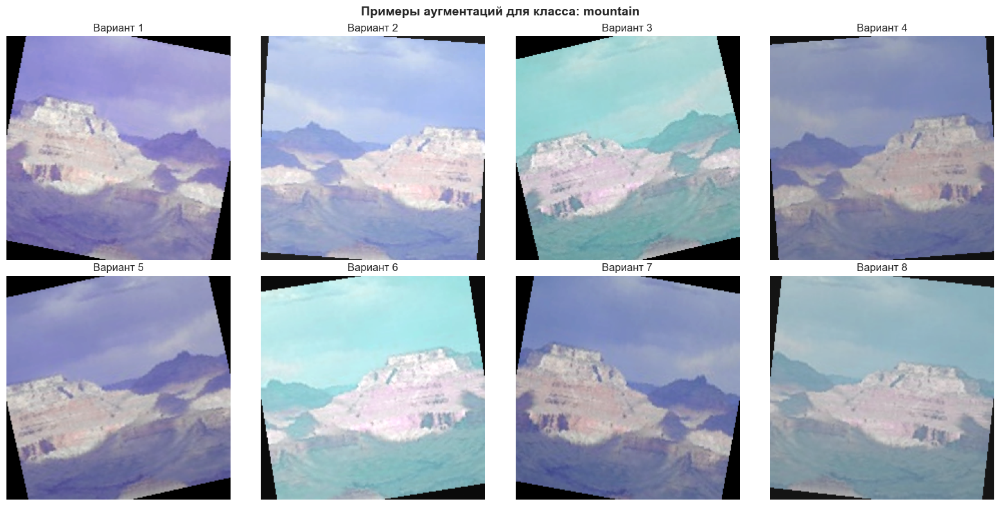

In [37]:
def show_augmentations(dataset, img_idx=0, num_augmentations=8):
    """Показывает различные аугментированные версии одного изображения"""

    # Получаем путь к исходному изображению
    img_path, label = dataset.samples[img_idx]
    class_name = dataset.classes[label]

    # Создаём фигуру
    fig, axes = plt.subplots(2, 4, figsize=(16, 8))
    fig.suptitle(f'Примеры аугментаций для класса: {class_name}', fontsize=14, fontweight='bold')
    axes = axes.flatten()

    for i in range(num_augmentations):
        # Применяем трансформации
        img_transformed = dataset.transform(Image.open(img_path))

        # Денормализуем для отображения
        img_show = denormalize(img_transformed).numpy().transpose(1, 2, 0)
        img_show = np.clip(img_show, 0, 1)

        axes[i].imshow(img_show)
        axes[i].set_title(f'Вариант {i+1}')
        axes[i].axis('off')

    plt.tight_layout()
    plt.show()

# Показываем аугментации для случайного изображения
random_idx = np.random.randint(0, len(train_dataset_augmented))
show_augmentations(train_dataset_augmented, img_idx=random_idx, num_augmentations=8)


Для наглядности посмотрим, как выглядят разные аугментированные версии одного и того же изображения.

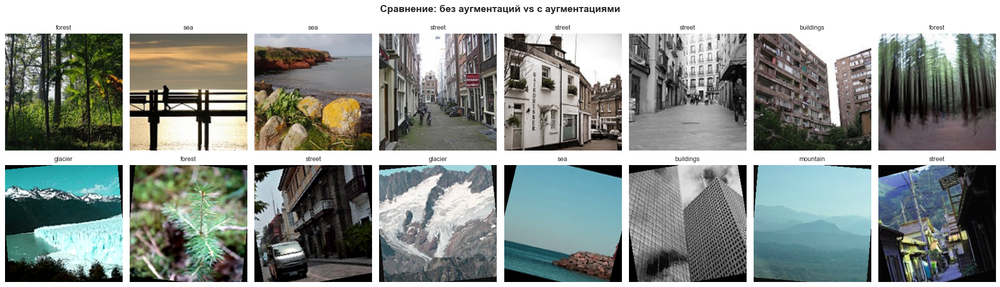

In [38]:
# Создаём Dataset БЕЗ аугментаций для сравнения
transform_train_no_aug = transforms.Compose([
    transforms.Resize((IMG_SIZE, IMG_SIZE)),
    transforms.ToTensor(),
    transforms.Normalize(mean=IMAGENET_MEAN, std=IMAGENET_STD)
])

train_dataset_no_aug = datasets.ImageFolder(root=TRAIN_DIR, transform=transform_train_no_aug)
train_loader_no_aug = DataLoader(train_dataset_no_aug, batch_size=8, shuffle=True)

# Функция для сравнения
def compare_augmentations():
    fig, axes = plt.subplots(2, 8, figsize=(20, 6))

    # Без аугментаций
    images_no_aug, labels_no_aug = next(iter(train_loader_no_aug))
    for i in range(8):
        img = denormalize(images_no_aug[i]).numpy().transpose(1, 2, 0)
        img = np.clip(img, 0, 1)
        axes[0, i].imshow(img)
        axes[0, i].set_title(class_names[labels_no_aug[i].item()], fontsize=9)
        axes[0, i].axis('off')
        if i == 0:
            axes[0, i].set_ylabel('БЕЗ аугментаций', fontsize=11, fontweight='bold')

    # С аугментациями
    images_aug, labels_aug = next(iter(train_loader))
    for i in range(8):
        img = denormalize(images_aug[i]).numpy().transpose(1, 2, 0)
        img = np.clip(img, 0, 1)
        axes[1, i].imshow(img)
        axes[1, i].set_title(class_names[labels_aug[i].item()], fontsize=9)
        axes[1, i].axis('off')
        if i == 0:
            axes[1, i].set_ylabel('С аугментациями', fontsize=11, fontweight='bold')

    plt.suptitle('Сравнение: без аугментаций vs с аугментациями', fontsize=14, fontweight='bold')
    plt.tight_layout()
    plt.show()

compare_augmentations()


# Пункт 6

Используется GPU через MPS (Metal Performance Shaders)
Устройство для обучения: mps
✓ Все файлы весов найдены в папке models

НАЧИНАЕМ ОБУЧЕНИЕ ВСЕХ МОДЕЛЕЙ
Модели для обучения: RESNET18, MOBILENET_V2, EFFICIENTNET_B0
Количество эпох для каждой: 4
Устройство: mps

############################################################
# МОДЕЛЬ 1/3: RESNET18
############################################################

ОБУЧЕНИЕ: RESNET18

Создание модели: RESNET18
   ✓ Загружены веса ImageNet
   Параметров: ~11.7M
   Input features: 512
   Всего параметров: 11,179,590
   Обучаемых: 11,179,590

Гиперпараметры:
   Epochs: 4
   Learning rate: 0.001
   Optimizer: AdamW (weight_decay=0.001)
   Scheduler: ReduceLROnPlateau
   Loss function: CrossEntropyLoss



Epoch 1/4 | LR: 0.001000 | Time: 130.4s
  Train: Loss=0.6126, Acc=78.45%
  Val:   Loss=0.4369, Acc=84.90%
Новая лучшая модель! Val Acc: 84.90%



Epoch 2/4 | LR: 0.001000 | Time: 122.6s
  Train: Loss=0.4482, Acc=84.50%
  Val:   Loss=0.3914, Acc=87.23%
Новая лучшая модель! Val Acc: 87.23%



Epoch 3/4 | LR: 0.001000 | Time: 120.3s
  Train: Loss=0.4018, Acc=85.93%
  Val:   Loss=0.4568, Acc=84.10%



Epoch 4/4 | LR: 0.001000 | Time: 125.2s
  Train: Loss=0.3618, Acc=87.50%
  Val:   Loss=0.4633, Acc=84.27%

ОБУЧЕНИЕ RESNET18 ЗАВЕРШЕНО
   Время: 8.31 мин (124.6s/epoch)
   Лучшая Val Acc: 87.23%

Обученная модель сохранена: best_model_resnet18.pth

############################################################
# МОДЕЛЬ 2/3: MOBILENET_V2
############################################################

ОБУЧЕНИЕ: MOBILENET_V2

Создание модели: MOBILENET_V2
   ✓ Загружены веса ImageNet
   Параметров: ~3.5M
   Input features: 1280
   Всего параметров: 2,231,558
   Обучаемых: 2,231,558

Гиперпараметры:
   Epochs: 4
   Learning rate: 0.0005
   Optimizer: AdamW (weight_decay=0.001)
   Scheduler: ReduceLROnPlateau
   Loss function: CrossEntropyLoss



Epoch 1/4 | LR: 0.000500 | Time: 181.7s
  Train: Loss=0.4336, Acc=85.14%
  Val:   Loss=0.2848, Acc=90.47%
Новая лучшая модель! Val Acc: 90.47%



Epoch 2/4 | LR: 0.000500 | Time: 152.8s
  Train: Loss=0.3370, Acc=88.24%
  Val:   Loss=0.2800, Acc=90.47%



Epoch 3/4 | LR: 0.000500 | Time: 164.3s
  Train: Loss=0.2994, Acc=89.65%
  Val:   Loss=0.2701, Acc=90.90%
Новая лучшая модель! Val Acc: 90.90%



Epoch 4/4 | LR: 0.000500 | Time: 156.6s
  Train: Loss=0.2866, Acc=90.09%
  Val:   Loss=0.3221, Acc=89.40%

ОБУЧЕНИЕ MOBILENET_V2 ЗАВЕРШЕНО
   Время: 10.92 мин (163.8s/epoch)
   Лучшая Val Acc: 90.90%

Обученная модель сохранена: best_model_mobilenet_v2.pth

############################################################
# МОДЕЛЬ 3/3: EFFICIENTNET_B0
############################################################

ОБУЧЕНИЕ: EFFICIENTNET_B0

Создание модели: EFFICIENTNET_B0
   ✓ Загружены веса ImageNet
   Параметров: ~5.3M
   Input features: 1280
   Всего параметров: 4,015,234
   Обучаемых: 4,015,234

Гиперпараметры:
   Epochs: 4
   Learning rate: 0.0005
   Optimizer: AdamW (weight_decay=0.001)
   Scheduler: ReduceLROnPlateau
   Loss function: CrossEntropyLoss



Epoch 1/4 | LR: 0.000500 | Time: 234.7s
  Train: Loss=0.3864, Acc=86.87%
  Val:   Loss=0.2578, Acc=91.23%
Новая лучшая модель! Val Acc: 91.23%



Epoch 2/4 | LR: 0.000500 | Time: 258.1s
  Train: Loss=0.2693, Acc=90.67%
  Val:   Loss=0.2106, Acc=93.23%
Новая лучшая модель! Val Acc: 93.23%



Epoch 3/4 | LR: 0.000500 | Time: 219.3s
  Train: Loss=0.2267, Acc=92.22%
  Val:   Loss=0.2514, Acc=91.03%



Epoch 4/4 | LR: 0.000500 | Time: 177.5s
  Train: Loss=0.2049, Acc=92.86%
  Val:   Loss=0.2051, Acc=92.77%

ОБУЧЕНИЕ EFFICIENTNET_B0 ЗАВЕРШЕНО
   Время: 14.83 мин (222.4s/epoch)
   Лучшая Val Acc: 93.23%

Обученная модель сохранена: best_model_efficientnet_b0.pth

ВИЗУАЛИЗАЦИЯ РЕЗУЛЬТАТОВ


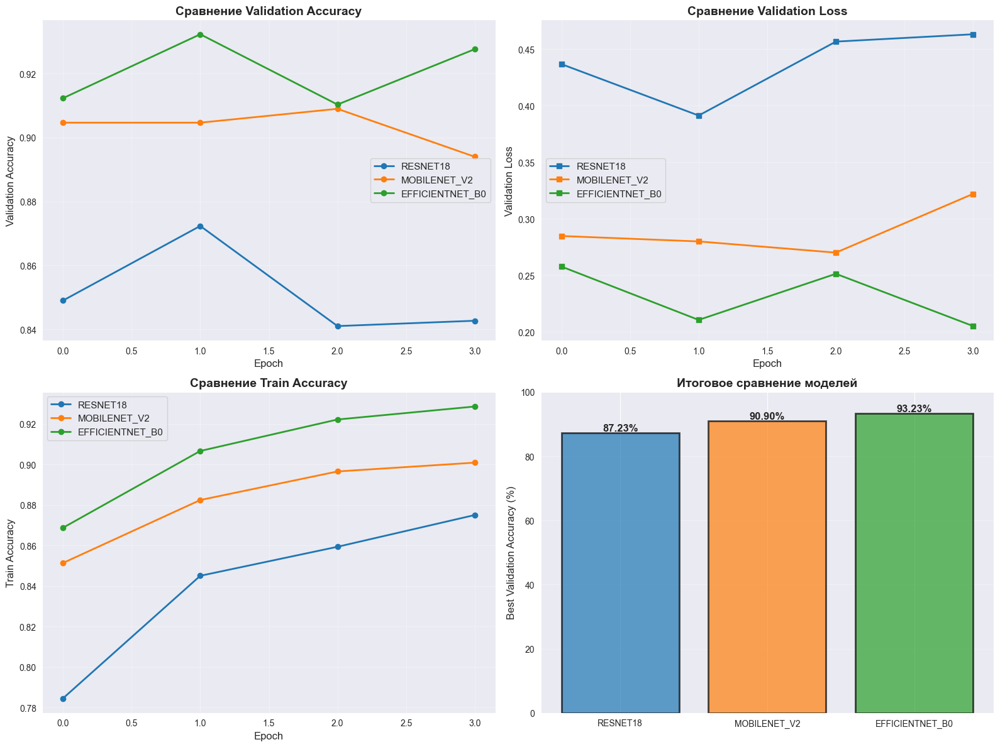

Графики сохранены: models_comparison.png

ИТОГОВАЯ ТАБЛИЦА СРАВНЕНИЯ

         Модель Best Val Acc (%) Final Train Acc (%) Final Val Acc (%) Переобучение (%) Параметров
       RESNET18            87.23               87.50             84.27             3.24      11.7M
   MOBILENET_V2            90.90               90.09             89.40             0.69       3.5M
EFFICIENTNET_B0            93.23               92.86             92.77             0.09       5.3M

ЛУЧШАЯ МОДЕЛЬ: EFFICIENTNET_B0
   Validation Accuracy: 93.23%
   Файл модели: best_model_efficientnet_b0.pth
   Исходные веса: models/efficientnet_b0.pth

ВСЕ МОДЕЛИ УСПЕШНО ОБУЧЕНЫ!
Обученные модели сохранены: best_model_*.pth
График сравнения: models_comparison.png


In [39]:
import torch.nn as nn
import torch.optim as optim
from torchvision import models
from tqdm import tqdm
import time
import copy
from pathlib import Path
import pandas as pd
import matplotlib.pyplot as plt

# Определяем устройство
if torch.backends.mps.is_available():
    device = torch.device("mps")
    print("Используется GPU через MPS (Metal Performance Shaders)")
elif torch.cuda.is_available():
    device = torch.device("cuda")
    print("Используется NVIDIA CUDA GPU")
else:
    device = torch.device("cpu")
    print("Используется CPU")

print(f"Устройство для обучения: {device}")

# Путь к моделям
models_dir = Path('models')

def create_model(model_name, num_classes, device, models_dir):
    """Создание модели с загрузкой предобученных весов из локальных файлов"""
    print(f"\nСоздание модели: {model_name.upper()}")

    if model_name == 'resnet18':
        # Создаём модель без весов
        model = models.resnet18(weights=None)

        # Загружаем предобученные веса из файла
        weights_path = models_dir / 'resnet18.pth'
        state_dict = torch.load(weights_path, map_location=device)
        model.load_state_dict(state_dict)

        # Заменяем последний слой
        num_features = model.fc.in_features
        model.fc = nn.Linear(num_features, num_classes)

        print(f"   ✓ Загружены веса ImageNet")
        print(f"   Параметров: ~11.7M")
        print(f"   Input features: {num_features}")

    elif model_name == 'mobilenet_v2':
        model = models.mobilenet_v2(weights=None)

        weights_path = models_dir / 'mobilenet_v2.pth'
        state_dict = torch.load(weights_path, map_location=device)
        model.load_state_dict(state_dict)

        num_features = model.classifier[1].in_features
        model.classifier = nn.Sequential(
            nn.Dropout(p=0.2),
            nn.Linear(num_features, num_classes)
        )

        print(f"   ✓ Загружены веса ImageNet")
        print(f"   Параметров: ~3.5M")
        print(f"   Input features: {num_features}")

    elif model_name == 'efficientnet_b0':
        model = models.efficientnet_b0(weights=None)

        weights_path = models_dir / 'efficientnet_b0.pth'
        state_dict = torch.load(weights_path, map_location=device)
        model.load_state_dict(state_dict)

        num_features = model.classifier[1].in_features
        model.classifier = nn.Sequential(
            nn.Dropout(p=0.3),
            nn.Linear(num_features, num_classes)
        )

        print(f"   ✓ Загружены веса ImageNet")
        print(f"   Параметров: ~5.3M")
        print(f"   Input features: {num_features}")

    else:
        raise ValueError(f"Неизвестная модель: {model_name}")

    model = model.to(device)

    total_params = sum(p.numel() for p in model.parameters())
    trainable_params = sum(p.numel() for p in model.parameters() if p.requires_grad)

    print(f"   Всего параметров: {total_params:,}")
    print(f"   Обучаемых: {trainable_params:,}")

    return model

def train_epoch(model, loader, criterion, optimizer, device):
    """Обучение одной эпохи"""
    model.train()
    running_loss = 0.0
    correct = 0
    total = 0

    pbar = tqdm(loader, desc='Training', leave=False)
    for inputs, labels in pbar:
        inputs, labels = inputs.to(device), labels.to(device)

        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()

        # Gradient clipping для стабильности
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)

        optimizer.step()

        running_loss += loss.item() * inputs.size(0)
        _, predicted = torch.max(outputs, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

        pbar.set_postfix({'loss': f'{loss.item():.4f}', 'acc': f'{100*correct/total:.2f}%'})

    return running_loss / total, correct / total

def validate(model, loader, criterion, device):
    """Валидация модели"""
    model.eval()
    running_loss = 0.0
    correct = 0
    total = 0

    with torch.no_grad():
        pbar = tqdm(loader, desc='Validation', leave=False)
        for inputs, labels in pbar:
            inputs, labels = inputs.to(device), labels.to(device)

            outputs = model(inputs)
            loss = criterion(outputs, labels)

            running_loss += loss.item() * inputs.size(0)
            _, predicted = torch.max(outputs, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

            pbar.set_postfix({'loss': f'{loss.item():.4f}', 'acc': f'{100*correct/total:.2f}%'})

    return running_loss / total, correct / total

def train_model(model_name, num_classes, device, train_loader, valid_loader, models_dir, num_epochs=3):
    """Полный цикл обучения модели"""
    print(f"\n{'='*60}")
    print(f"ОБУЧЕНИЕ: {model_name.upper()}")
    print(f"{'='*60}")

    model = create_model(model_name, num_classes, device, models_dir)

    # Гиперпараметры в зависимости от модели
    if model_name == 'resnet18':
        lr = 0.001
        weight_decay = 0.001
    elif model_name == 'mobilenet_v2':
        lr = 0.0005
        weight_decay = 0.001
    else:  # efficientnet_b0
        lr = 0.0005
        weight_decay = 0.001

    criterion = nn.CrossEntropyLoss()
    optimizer = optim.AdamW(model.parameters(), lr=lr, weight_decay=weight_decay)
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(
        optimizer, mode='min', factor=0.3, patience=3, min_lr=1e-7
    )

    print(f"\nГиперпараметры:")
    print(f"   Epochs: {num_epochs}")
    print(f"   Learning rate: {lr}")
    print(f"   Optimizer: AdamW (weight_decay={weight_decay})")
    print(f"   Scheduler: ReduceLROnPlateau")
    print(f"   Loss function: CrossEntropyLoss")

    history = {
        'train_loss': [],
        'train_acc': [],
        'val_loss': [],
        'val_acc': [],
        'learning_rates': []
    }

    best_val_acc = 0.0
    best_model_state = None

    start_time = time.time()

    for epoch in range(num_epochs):
        epoch_start = time.time()

        current_lr = optimizer.param_groups[0]['lr']

        # Обучение
        train_loss, train_acc = train_epoch(model, train_loader, criterion, optimizer, device)

        # Валидация
        val_loss, val_acc = validate(model, valid_loader, criterion, device)

        # Обновляем learning rate
        scheduler.step(val_loss)

        # Сохраняем историю
        history['train_loss'].append(train_loss)
        history['train_acc'].append(train_acc)
        history['val_loss'].append(val_loss)
        history['val_acc'].append(val_acc)
        history['learning_rates'].append(current_lr)

        epoch_time = time.time() - epoch_start

        # Вывод результатов эпохи
        print(f"\nEpoch {epoch+1}/{num_epochs} | LR: {current_lr:.6f} | Time: {epoch_time:.1f}s")
        print(f"  Train: Loss={train_loss:.4f}, Acc={train_acc*100:.2f}%")
        print(f"  Val:   Loss={val_loss:.4f}, Acc={val_acc*100:.2f}%")

        # Сохраняем лучшую модель
        if val_acc > best_val_acc:
            best_val_acc = val_acc
            best_model_state = copy.deepcopy(model.state_dict())
            print(f"Новая лучшая модель! Val Acc: {val_acc*100:.2f}%")

    training_time = time.time() - start_time

    print(f"\n{'='*60}")
    print(f"ОБУЧЕНИЕ {model_name.upper()} ЗАВЕРШЕНО")
    print(f"{'='*60}")
    print(f"   Время: {training_time/60:.2f} мин ({training_time/num_epochs:.1f}s/epoch)")
    print(f"   Лучшая Val Acc: {best_val_acc*100:.2f}%")

    return best_model_state, history, best_val_acc

# Проверка наличия файлов
if not models_dir.exists():
    raise FileNotFoundError(f"Папка {models_dir} не найдена! Убедитесь, что она существует.")

required_files = ['resnet18.pth', 'mobilenet_v2.pth', 'efficientnet_b0.pth']
for file in required_files:
    if not (models_dir / file).exists():
        raise FileNotFoundError(f"Файл {models_dir / file} не найден!")

print(f"✓ Все файлы весов найдены в папке {models_dir}")

# Параметры обучения
num_epochs = 4
models_to_train = ['resnet18', 'mobilenet_v2', 'efficientnet_b0']

all_results = {}

print("\n" + "="*60)
print("НАЧИНАЕМ ОБУЧЕНИЕ ВСЕХ МОДЕЛЕЙ")
print("="*60)
print(f"Модели для обучения: {', '.join([m.upper() for m in models_to_train])}")
print(f"Количество эпох для каждой: {num_epochs}")
print(f"Устройство: {device}")

# Обучаем все модели
for idx, model_name in enumerate(models_to_train, 1):
    print(f"\n{'#'*60}")
    print(f"# МОДЕЛЬ {idx}/{len(models_to_train)}: {model_name.upper()}")
    print(f"{'#'*60}")

    best_state, history, best_acc = train_model(
        model_name=model_name,
        num_classes=num_classes,
        device=device,
        train_loader=train_loader,
        valid_loader=test_loader,
        models_dir=models_dir,
        num_epochs=num_epochs
    )

    all_results[model_name] = {
        'best_state': best_state,
        'history': history,
        'best_val_acc': best_acc
    }

    # Сохраняем обученную модель
    save_path = f'best_model_{model_name}.pth'
    torch.save({
        'model_state_dict': best_state,
        'val_acc': best_acc,
        'history': history
    }, save_path)
    print(f"\nОбученная модель сохранена: {save_path}")

# Визуализация результатов
print("\n" + "="*60)
print("ВИЗУАЛИЗАЦИЯ РЕЗУЛЬТАТОВ")
print("="*60)

fig, axes = plt.subplots(2, 2, figsize=(16, 12))

# Validation Accuracy
for model_name, results in all_results.items():
    axes[0, 0].plot(results['history']['val_acc'],
                    label=model_name.upper(),
                    marker='o',
                    linewidth=2)
axes[0, 0].set_xlabel('Epoch', fontsize=12)
axes[0, 0].set_ylabel('Validation Accuracy', fontsize=12)
axes[0, 0].set_title('Сравнение Validation Accuracy', fontsize=14, fontweight='bold')
axes[0, 0].legend(fontsize=11)
axes[0, 0].grid(alpha=0.3)

# Validation Loss
for model_name, results in all_results.items():
    axes[0, 1].plot(results['history']['val_loss'],
                    label=model_name.upper(),
                    marker='s',
                    linewidth=2)
axes[0, 1].set_xlabel('Epoch', fontsize=12)
axes[0, 1].set_ylabel('Validation Loss', fontsize=12)
axes[0, 1].set_title('Сравнение Validation Loss', fontsize=14, fontweight='bold')
axes[0, 1].legend(fontsize=11)
axes[0, 1].grid(alpha=0.3)

# Train Accuracy
for model_name, results in all_results.items():
    axes[1, 0].plot(results['history']['train_acc'],
                    label=model_name.upper(),
                    marker='o',
                    linewidth=2)
axes[1, 0].set_xlabel('Epoch', fontsize=12)
axes[1, 0].set_ylabel('Train Accuracy', fontsize=12)
axes[1, 0].set_title('Сравнение Train Accuracy', fontsize=14, fontweight='bold')
axes[1, 0].legend(fontsize=11)
axes[1, 0].grid(alpha=0.3)

# Bar chart сравнения
model_names = [m.upper() for m in all_results.keys()]
best_accs = [results['best_val_acc'] * 100 for results in all_results.values()]
colors = ['#1f77b4', '#ff7f0e', '#2ca02c']

bars = axes[1, 1].bar(model_names, best_accs, color=colors, alpha=0.7, edgecolor='black', linewidth=2)
axes[1, 1].set_ylabel('Best Validation Accuracy (%)', fontsize=12)
axes[1, 1].set_title('Итоговое сравнение моделей', fontsize=14, fontweight='bold')
axes[1, 1].set_ylim([0, 100])
axes[1, 1].grid(alpha=0.3, axis='y')

for bar, acc in zip(bars, best_accs):
    height = bar.get_height()
    axes[1, 1].text(bar.get_x() + bar.get_width()/2., height,
                    f'{acc:.2f}%',
                    ha='center', va='bottom', fontsize=12, fontweight='bold')

plt.tight_layout()
plt.savefig('models_comparison.png', dpi=150, bbox_inches='tight')
plt.show()

print("Графики сохранены: models_comparison.png")

# Итоговая таблица
print("\n" + "="*60)
print("ИТОГОВАЯ ТАБЛИЦА СРАВНЕНИЯ")
print("="*60 + "\n")

comparison_data = {
    'Модель': [],
    'Best Val Acc (%)': [],
    'Final Train Acc (%)': [],
    'Final Val Acc (%)': [],
    'Переобучение (%)': [],
    'Параметров': []
}

param_counts = {
    'resnet18': '11.7M',
    'mobilenet_v2': '3.5M',
    'efficientnet_b0': '5.3M'
}

for model_name, results in all_results.items():
    history = results['history']
    best_val = results['best_val_acc'] * 100
    final_train = history['train_acc'][-1] * 100
    final_val = history['val_acc'][-1] * 100
    overfitting = final_train - final_val

    comparison_data['Модель'].append(model_name.upper())
    comparison_data['Best Val Acc (%)'].append(f'{best_val:.2f}')
    comparison_data['Final Train Acc (%)'].append(f'{final_train:.2f}')
    comparison_data['Final Val Acc (%)'].append(f'{final_val:.2f}')
    comparison_data['Переобучение (%)'].append(f'{overfitting:.2f}')
    comparison_data['Параметров'].append(param_counts[model_name])

comparison_df = pd.DataFrame(comparison_data)
print(comparison_df.to_string(index=False))

# Лучшая модель
best_model_name = max(all_results.items(), key=lambda x: x[1]['best_val_acc'])[0]
best_model_acc = all_results[best_model_name]['best_val_acc'] * 100

print("\n" + "="*60)
print(f"ЛУЧШАЯ МОДЕЛЬ: {best_model_name.upper()}")
print("="*60)
print(f"   Validation Accuracy: {best_model_acc:.2f}%")
print(f"   Файл модели: best_model_{best_model_name}.pth")
print(f"   Исходные веса: models/{best_model_name}.pth")

print("\n" + "="*60)
print("ВСЕ МОДЕЛИ УСПЕШНО ОБУЧЕНЫ!")
print("="*60)
print(f"Обученные модели сохранены: best_model_*.pth")
print(f"График сравнения: models_comparison.png")


# 7 пункт

In [41]:
from sklearn.metrics import (
    accuracy_score, precision_score, recall_score, f1_score,
    confusion_matrix, classification_report, roc_auc_score, roc_curve
)
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm

def get_predictions(model, loader, device):
    """Получение предсказаний модели для всего датасета"""
    model.eval()
    all_preds = []
    all_labels = []
    all_probs = []

    with torch.no_grad():
        for images, labels in tqdm(loader, desc='Getting predictions'):
            images = images.to(device)
            outputs = model(images)
            probs = torch.softmax(outputs, dim=1)
            _, predicted = torch.max(outputs, 1)

            all_preds.extend(predicted.cpu().numpy())
            all_labels.extend(labels.numpy())
            all_probs.extend(probs.cpu().numpy())

    return np.array(all_preds), np.array(all_labels), np.array(all_probs)

def calculate_metrics(y_true, y_pred, y_probs, class_names):
    """Расчёт всех метрик классификации"""

    # Базовые метрики
    accuracy = accuracy_score(y_true, y_pred)

    # Macro и Micro метрики
    precision_macro = precision_score(y_true, y_pred, average='macro', zero_division=0)
    precision_micro = precision_score(y_true, y_pred, average='micro', zero_division=0)

    recall_macro = recall_score(y_true, y_pred, average='macro', zero_division=0)
    recall_micro = recall_score(y_true, y_pred, average='micro', zero_division=0)

    f1_macro = f1_score(y_true, y_pred, average='macro', zero_division=0)
    f1_micro = f1_score(y_true, y_pred, average='micro', zero_division=0)

    # Per-class метрики
    precision_per_class = precision_score(y_true, y_pred, average=None, zero_division=0)
    recall_per_class = recall_score(y_true, y_pred, average=None, zero_division=0)
    f1_per_class = f1_score(y_true, y_pred, average=None, zero_division=0)

    metrics = {
        'accuracy': accuracy,
        'precision_macro': precision_macro,
        'precision_micro': precision_micro,
        'recall_macro': recall_macro,
        'recall_micro': recall_micro,
        'f1_macro': f1_macro,
        'f1_micro': f1_micro,
        'precision_per_class': precision_per_class,
        'recall_per_class': recall_per_class,
        'f1_per_class': f1_per_class
    }

    return metrics

# Загружаем лучшие модели
print("="*60)
print("ЗАГРУЗКА ОБУЧЕННЫХ МОДЕЛЕЙ")
print("="*60 + "\n")

models_dict = {}
models_to_evaluate = ['resnet18', 'mobilenet_v2', 'efficientnet_b0']

for model_name in models_to_evaluate:
    print(f"Загрузка {model_name.upper()}...")

    # Создаём модель
    model = create_model(model_name, num_classes, device, models_dir)

    # Загружаем обученные веса
    checkpoint = torch.load(f'best_model_{model_name}.pth', map_location=device)
    model.load_state_dict(checkpoint['model_state_dict'])
    model.to(device)
    model.eval()

    models_dict[model_name] = model
    print(f"✓ {model_name.upper()} загружена")

print(f"\n✓ Загружено {len(models_dict)} моделей\n")

# Получаем предсказания для всех моделей
print("="*60)
print("ПОЛУЧЕНИЕ ПРЕДСКАЗАНИЙ")
print("="*60 + "\n")

predictions_dict = {}

for model_name, model in models_dict.items():
    print(f"\n{model_name.upper()}:")
    print("-" * 40)

    # Train predictions
    print("  Train set...")
    train_preds, train_labels, train_probs = get_predictions(model, train_loader, device)

    # Test predictions
    print("  Test set...")
    test_preds, test_labels, test_probs = get_predictions(model, test_loader, device)

    predictions_dict[model_name] = {
        'train': (train_preds, train_labels, train_probs),
        'test': (test_preds, test_labels, test_probs)
    }

    print(f"  ✓ Предсказания получены")

print("\n✓ Все предсказания получены\n")

# Расчёт метрик для всех моделей
print("="*60)
print("РАСЧЁТ МЕТРИК КАЧЕСТВА")
print("="*60 + "\n")

all_metrics = {}

for model_name in models_to_evaluate:
    print(f"\n{'='*60}")
    print(f"МОДЕЛЬ: {model_name.upper()}")
    print(f"{'='*60}")

    train_preds, train_labels, train_probs = predictions_dict[model_name]['train']
    test_preds, test_labels, test_probs = predictions_dict[model_name]['test']

    # Метрики для train
    train_metrics = calculate_metrics(train_labels, train_preds, train_probs, class_names)

    # Метрики для test
    test_metrics = calculate_metrics(test_labels, test_preds, test_probs, class_names)

    all_metrics[model_name] = {
        'train': train_metrics,
        'test': test_metrics
    }

    # Выводим результаты
    print("\nTRAIN SET:")
    print(f"  Accuracy:        {train_metrics['accuracy']*100:.2f}%")
    print(f"  Precision (macro): {train_metrics['precision_macro']*100:.2f}%")
    print(f"  Recall (macro):    {train_metrics['recall_macro']*100:.2f}%")
    print(f"  F1-score (macro):  {train_metrics['f1_macro']*100:.2f}%")

    print("\nTEST SET:")
    print(f"  Accuracy:        {test_metrics['accuracy']*100:.2f}%")
    print(f"  Precision (macro): {test_metrics['precision_macro']*100:.2f}%")
    print(f"  Recall (macro):    {test_metrics['recall_macro']*100:.2f}%")
    print(f"  F1-score (macro):  {test_metrics['f1_macro']*100:.2f}%")

# Сводная таблица метрик
print("\n" + "="*60)
print("СВОДНАЯ ТАБЛИЦА МЕТРИК")
print("="*60 + "\n")

metrics_comparison = []

for model_name in models_to_evaluate:
    train_m = all_metrics[model_name]['train']
    test_m = all_metrics[model_name]['test']

    metrics_comparison.append({
        'Модель': model_name.upper(),
        'Train Acc': f"{train_m['accuracy']*100:.2f}%",
        'Test Acc': f"{test_m['accuracy']*100:.2f}%",
        'Test Precision': f"{test_m['precision_macro']*100:.2f}%",
        'Test Recall': f"{test_m['recall_macro']*100:.2f}%",
        'Test F1': f"{test_m['f1_macro']*100:.2f}%"
    })

metrics_df = pd.DataFrame(metrics_comparison)
print(metrics_df.to_string(index=False))

# Детальные метрики по классам для лучшей модели
best_model_name = max(all_metrics.items(),
                      key=lambda x: x[1]['test']['accuracy'])[0]

print("\n" + "="*60)
print(f"ДЕТАЛЬНЫЕ МЕТРИКИ ПО КЛАССАМ: {best_model_name.upper()}")
print("="*60 + "\n")

test_m = all_metrics[best_model_name]['test']

per_class_data = []
for i, class_name in enumerate(class_names):
    per_class_data.append({
        'Класс': class_name,
        'Precision': f"{test_m['precision_per_class'][i]*100:.2f}%",
        'Recall': f"{test_m['recall_per_class'][i]*100:.2f}%",
        'F1-score': f"{test_m['f1_per_class'][i]*100:.2f}%"
    })

per_class_df = pd.DataFrame(per_class_data)
print(per_class_df.to_string(index=False))

# Classification Report
print("\n" + "="*60)
print("CLASSIFICATION REPORT")
print("="*60 + "\n")

test_preds, test_labels, _ = predictions_dict[best_model_name]['test']
print(classification_report(test_labels, test_preds,
                          target_names=class_names,
                          digits=4))


ЗАГРУЗКА ОБУЧЕННЫХ МОДЕЛЕЙ

Загрузка RESNET18...

Создание модели: RESNET18
   ✓ Загружены веса ImageNet
   Параметров: ~11.7M
   Input features: 512
   Всего параметров: 11,179,590
   Обучаемых: 11,179,590
✓ RESNET18 загружена
Загрузка MOBILENET_V2...

Создание модели: MOBILENET_V2
   ✓ Загружены веса ImageNet
   Параметров: ~3.5M
   Input features: 1280
   Всего параметров: 2,231,558
   Обучаемых: 2,231,558
✓ MOBILENET_V2 загружена
Загрузка EFFICIENTNET_B0...

Создание модели: EFFICIENTNET_B0
   ✓ Загружены веса ImageNet
   Параметров: ~5.3M
   Input features: 1280
   Всего параметров: 4,015,234
   Обучаемых: 4,015,234
✓ EFFICIENTNET_B0 загружена

✓ Загружено 3 моделей

ПОЛУЧЕНИЕ ПРЕДСКАЗАНИЙ


RESNET18:
----------------------------------------
  Train set...


Getting predictions: 100%|██████████| 439/439 [00:42<00:00, 10.28it/s]


  Test set...


Getting predictions: 100%|██████████| 94/94 [00:25<00:00,  3.62it/s]


  ✓ Предсказания получены

MOBILENET_V2:
----------------------------------------
  Train set...


Getting predictions: 100%|██████████| 439/439 [00:45<00:00,  9.64it/s]


  Test set...


Getting predictions: 100%|██████████| 94/94 [00:26<00:00,  3.51it/s]


  ✓ Предсказания получены

EFFICIENTNET_B0:
----------------------------------------
  Train set...


Getting predictions: 100%|██████████| 439/439 [00:50<00:00,  8.66it/s]


  Test set...


Getting predictions: 100%|██████████| 94/94 [00:29<00:00,  3.22it/s]

  ✓ Предсказания получены

✓ Все предсказания получены

РАСЧЁТ МЕТРИК КАЧЕСТВА


МОДЕЛЬ: RESNET18

TRAIN SET:
  Accuracy:        85.01%
  Precision (macro): 85.88%
  Recall (macro):    85.01%
  F1-score (macro):  85.06%

TEST SET:
  Accuracy:        87.23%
  Precision (macro): 87.80%
  Recall (macro):    87.41%
  F1-score (macro):  87.45%

МОДЕЛЬ: MOBILENET_V2

TRAIN SET:
  Accuracy:        91.71%
  Precision (macro): 92.05%
  Recall (macro):    91.71%
  F1-score (macro):  91.79%

TEST SET:
  Accuracy:        90.90%
  Precision (macro): 91.45%
  Recall (macro):    90.97%
  F1-score (macro):  91.04%

МОДЕЛЬ: EFFICIENTNET_B0

TRAIN SET:
  Accuracy:        94.36%
  Precision (macro): 94.75%
  Recall (macro):    94.43%
  F1-score (macro):  94.47%

TEST SET:
  Accuracy:        93.23%
  Precision (macro): 93.48%
  Recall (macro):    93.48%
  F1-score (macro):  93.38%

СВОДНАЯ ТАБЛИЦА МЕТРИК

         Модель Train Acc Test Acc Test Precision Test Recall Test F1
       RESNET18    85.01%   87.

# 7.1 Matrix

МАТРИЦЫ ОШИБОК (CONFUSION MATRIX)


RESNET18


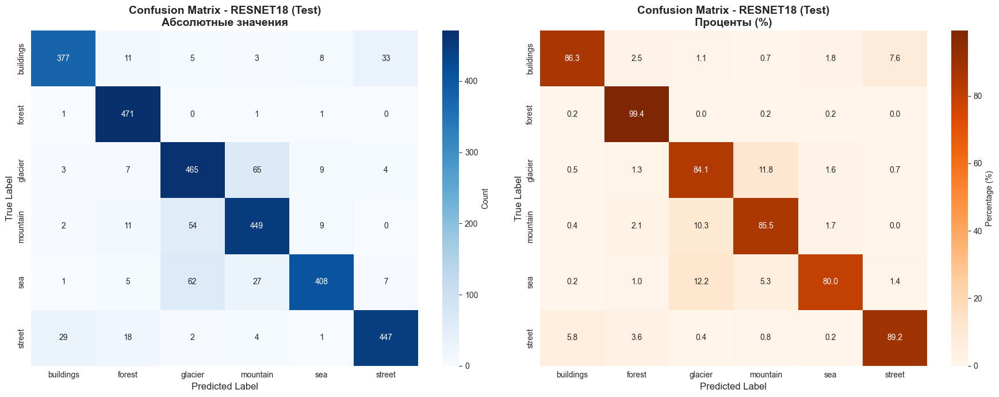

✓ Сохранено: confusion_matrix_resnet18.png

MOBILENET_V2


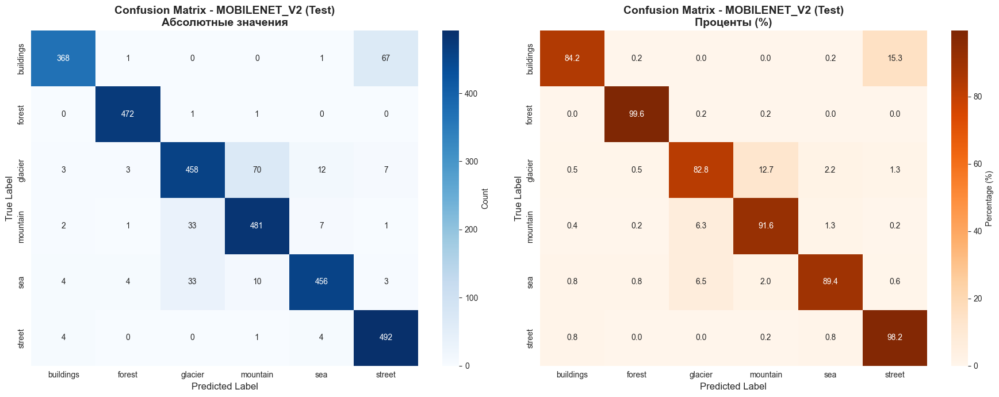

✓ Сохранено: confusion_matrix_mobilenet_v2.png

EFFICIENTNET_B0


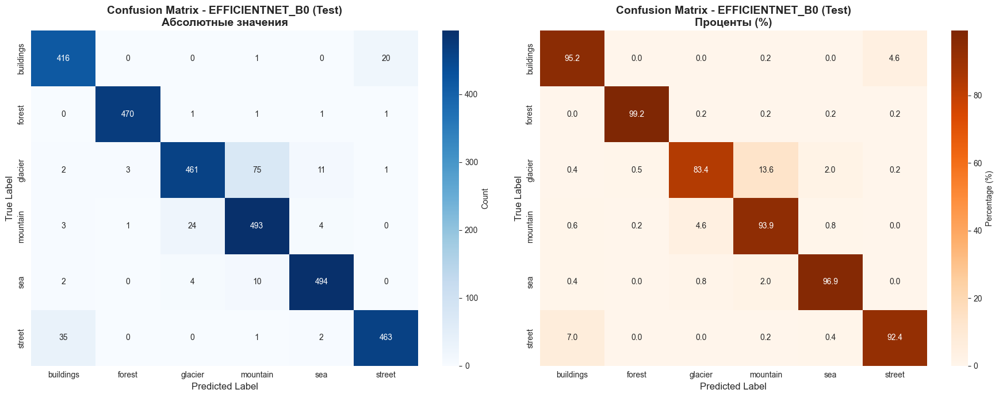

✓ Сохранено: confusion_matrix_efficientnet_b0.png

АНАЛИЗ ЧАСТЫХ ОШИБОК


RESNET18:
----------------------------------------
  Топ-5 самых частых ошибок:
    glacier      → mountain    :   65 раз
    sea          → glacier     :   62 раз
    mountain     → glacier     :   54 раз
    buildings    → street      :   33 раз
    street       → buildings   :   29 раз

MOBILENET_V2:
----------------------------------------
  Топ-5 самых частых ошибок:
    glacier      → mountain    :   70 раз
    buildings    → street      :   67 раз
    sea          → glacier     :   33 раз
    mountain     → glacier     :   33 раз
    glacier      → sea         :   12 раз

EFFICIENTNET_B0:
----------------------------------------
  Топ-5 самых частых ошибок:
    glacier      → mountain    :   75 раз
    street       → buildings   :   35 раз
    mountain     → glacier     :   24 раз
    buildings    → street      :   20 раз
    glacier      → sea         :   11 раз


In [42]:
def plot_confusion_matrix(y_true, y_pred, class_names, model_name, dataset='Test'):
    """Построение матрицы ошибок"""
    cm = confusion_matrix(y_true, y_pred)

    # Нормализованная матрица (в процентах)
    cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis] * 100

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 7))

    # Абсолютные значения
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=class_names, yticklabels=class_names,
                ax=ax1, cbar_kws={'label': 'Count'})
    ax1.set_title(f'Confusion Matrix - {model_name.upper()} ({dataset})\nАбсолютные значения',
                  fontsize=14, fontweight='bold')
    ax1.set_ylabel('True Label', fontsize=12)
    ax1.set_xlabel('Predicted Label', fontsize=12)

    # Нормализованные значения (%)
    sns.heatmap(cm_normalized, annot=True, fmt='.1f', cmap='Oranges',
                xticklabels=class_names, yticklabels=class_names,
                ax=ax2, cbar_kws={'label': 'Percentage (%)'})
    ax2.set_title(f'Confusion Matrix - {model_name.upper()} ({dataset})\nПроценты (%)',
                  fontsize=14, fontweight='bold')
    ax2.set_ylabel('True Label', fontsize=12)
    ax2.set_xlabel('Predicted Label', fontsize=12)

    plt.tight_layout()
    return fig, cm

print("="*60)
print("МАТРИЦЫ ОШИБОК (CONFUSION MATRIX)")
print("="*60 + "\n")

# Строим confusion matrix для всех моделей
for model_name in models_to_evaluate:
    print(f"\n{model_name.upper()}")

    test_preds, test_labels, _ = predictions_dict[model_name]['test']

    fig, cm = plot_confusion_matrix(test_labels, test_preds,
                                    class_names, model_name, 'Test')

    plt.savefig(f'confusion_matrix_{model_name}.png', dpi=150, bbox_inches='tight')
    plt.show()

    print(f"✓ Сохранено: confusion_matrix_{model_name}.png")

# Анализ ошибок
print("\n" + "="*60)
print("АНАЛИЗ ЧАСТЫХ ОШИБОК")
print("="*60 + "\n")

for model_name in models_to_evaluate:
    print(f"\n{model_name.upper()}:")
    print("-" * 40)

    test_preds, test_labels, _ = predictions_dict[model_name]['test']
    cm = confusion_matrix(test_labels, test_preds)

    # Находим самые частые ошибки (не диагональные элементы)
    errors = []
    for i in range(len(class_names)):
        for j in range(len(class_names)):
            if i != j and cm[i, j] > 0:
                errors.append((cm[i, j], class_names[i], class_names[j]))

    errors.sort(reverse=True)

    print("  Топ-5 самых частых ошибок:")
    for count, true_class, pred_class in errors[:5]:
        print(f"    {true_class:12s} → {pred_class:12s}: {count:4d} раз")


# 7.3 ROC


ROC-КРИВЫЕ


RESNET18


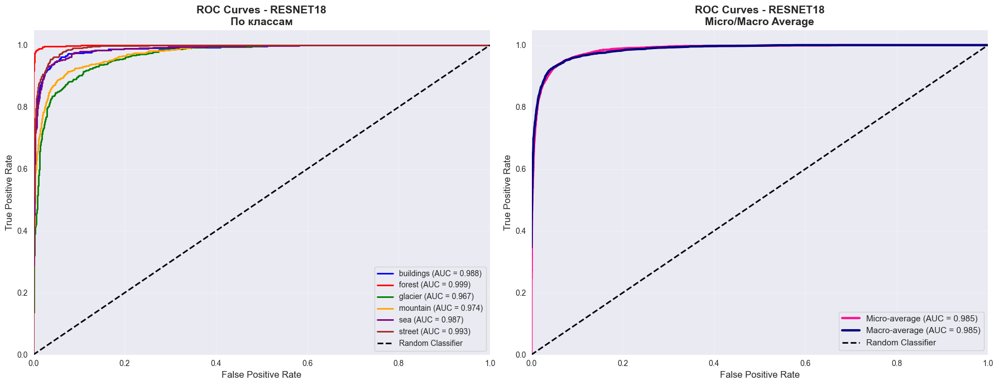

✓ Сохранено: roc_curves_resnet18.png
  Macro AUC: 0.9846
  Micro AUC: 0.9850

MOBILENET_V2


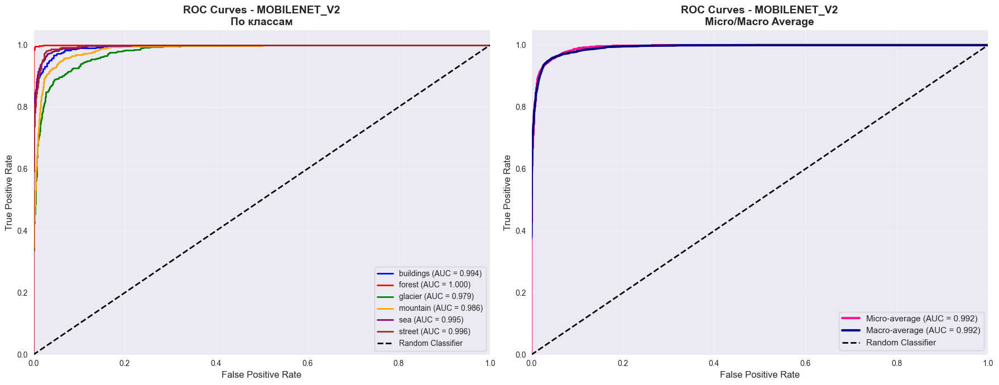

✓ Сохранено: roc_curves_mobilenet_v2.png
  Macro AUC: 0.9915
  Micro AUC: 0.9923

EFFICIENTNET_B0


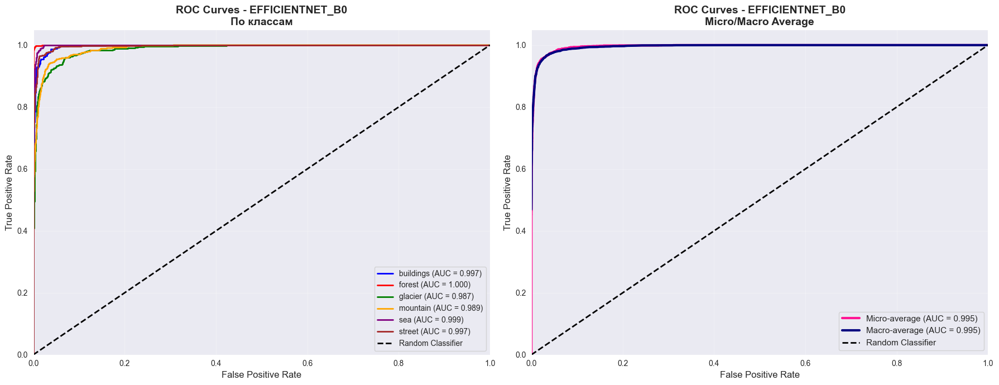

✓ Сохранено: roc_curves_efficientnet_b0.png
  Macro AUC: 0.9947
  Micro AUC: 0.9953

СРАВНЕНИЕ AUC

         Модель Macro AUC Micro AUC
       RESNET18    0.9846    0.9850
   MOBILENET_V2    0.9915    0.9923
EFFICIENTNET_B0    0.9947    0.9953


In [43]:
from sklearn.preprocessing import label_binarize
from itertools import cycle

def plot_roc_curves(y_true, y_probs, class_names, model_name):
    """Построение ROC-кривых для всех классов"""

    # Бинаризация меток для multi-class ROC
    y_true_bin = label_binarize(y_true, classes=range(len(class_names)))

    # Вычисляем ROC-кривую и AUC для каждого класса
    fpr = dict()
    tpr = dict()
    roc_auc = dict()

    for i in range(len(class_names)):
        fpr[i], tpr[i], _ = roc_curve(y_true_bin[:, i], y_probs[:, i])
        roc_auc[i] = roc_auc_score(y_true_bin[:, i], y_probs[:, i])

    # Micro-average ROC
    fpr["micro"], tpr["micro"], _ = roc_curve(y_true_bin.ravel(), y_probs.ravel())
    roc_auc["micro"] = roc_auc_score(y_true_bin, y_probs, average='micro')

    # Macro-average ROC
    all_fpr = np.unique(np.concatenate([fpr[i] for i in range(len(class_names))]))
    mean_tpr = np.zeros_like(all_fpr)
    for i in range(len(class_names)):
        mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
    mean_tpr /= len(class_names)
    fpr["macro"] = all_fpr
    tpr["macro"] = mean_tpr
    roc_auc["macro"] = roc_auc_score(y_true_bin, y_probs, average='macro')

    # Построение графиков
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 7))

    # График 1: Все классы
    colors = cycle(['blue', 'red', 'green', 'orange', 'purple', 'brown'])
    for i, color in zip(range(len(class_names)), colors):
        ax1.plot(fpr[i], tpr[i], color=color, lw=2,
                label=f'{class_names[i]} (AUC = {roc_auc[i]:.3f})')

    ax1.plot([0, 1], [0, 1], 'k--', lw=2, label='Random Classifier')
    ax1.set_xlim([0.0, 1.0])
    ax1.set_ylim([0.0, 1.05])
    ax1.set_xlabel('False Positive Rate', fontsize=12)
    ax1.set_ylabel('True Positive Rate', fontsize=12)
    ax1.set_title(f'ROC Curves - {model_name.upper()}\nПо классам',
                  fontsize=14, fontweight='bold')
    ax1.legend(loc="lower right", fontsize=10)
    ax1.grid(alpha=0.3)

    # График 2: Micro и Macro average
    ax2.plot(fpr["micro"], tpr["micro"], color='deeppink', lw=3,
            label=f'Micro-average (AUC = {roc_auc["micro"]:.3f})')
    ax2.plot(fpr["macro"], tpr["macro"], color='navy', lw=3,
            label=f'Macro-average (AUC = {roc_auc["macro"]:.3f})')
    ax2.plot([0, 1], [0, 1], 'k--', lw=2, label='Random Classifier')

    ax2.set_xlim([0.0, 1.0])
    ax2.set_ylim([0.0, 1.05])
    ax2.set_xlabel('False Positive Rate', fontsize=12)
    ax2.set_ylabel('True Positive Rate', fontsize=12)
    ax2.set_title(f'ROC Curves - {model_name.upper()}\nMicro/Macro Average',
                  fontsize=14, fontweight='bold')
    ax2.legend(loc="lower right", fontsize=11)
    ax2.grid(alpha=0.3)

    plt.tight_layout()
    return fig, roc_auc

print("\n" + "="*60)
print("ROC-КРИВЫЕ")
print("="*60 + "\n")

roc_results = {}

for model_name in models_to_evaluate:
    print(f"\n{model_name.upper()}")

    test_preds, test_labels, test_probs = predictions_dict[model_name]['test']

    fig, roc_auc = plot_roc_curves(test_labels, test_probs,
                                    class_names, model_name)

    roc_results[model_name] = roc_auc

    plt.savefig(f'roc_curves_{model_name}.png', dpi=150, bbox_inches='tight')
    plt.show()

    print(f"✓ Сохранено: roc_curves_{model_name}.png")
    print(f"  Macro AUC: {roc_auc['macro']:.4f}")
    print(f"  Micro AUC: {roc_auc['micro']:.4f}")

# Сравнение AUC всех моделей
print("\n" + "="*60)
print("СРАВНЕНИЕ AUC")
print("="*60 + "\n")

auc_comparison = []
for model_name in models_to_evaluate:
    auc_comparison.append({
        'Модель': model_name.upper(),
        'Macro AUC': f"{roc_results[model_name]['macro']:.4f}",
        'Micro AUC': f"{roc_results[model_name]['micro']:.4f}"
    })

auc_df = pd.DataFrame(auc_comparison)
print(auc_df.to_string(index=False))


# 8


ПУНКТ 8: СРАВНЕНИЕ РЕЗУЛЬТАТОВ И ВЫВОДЫ



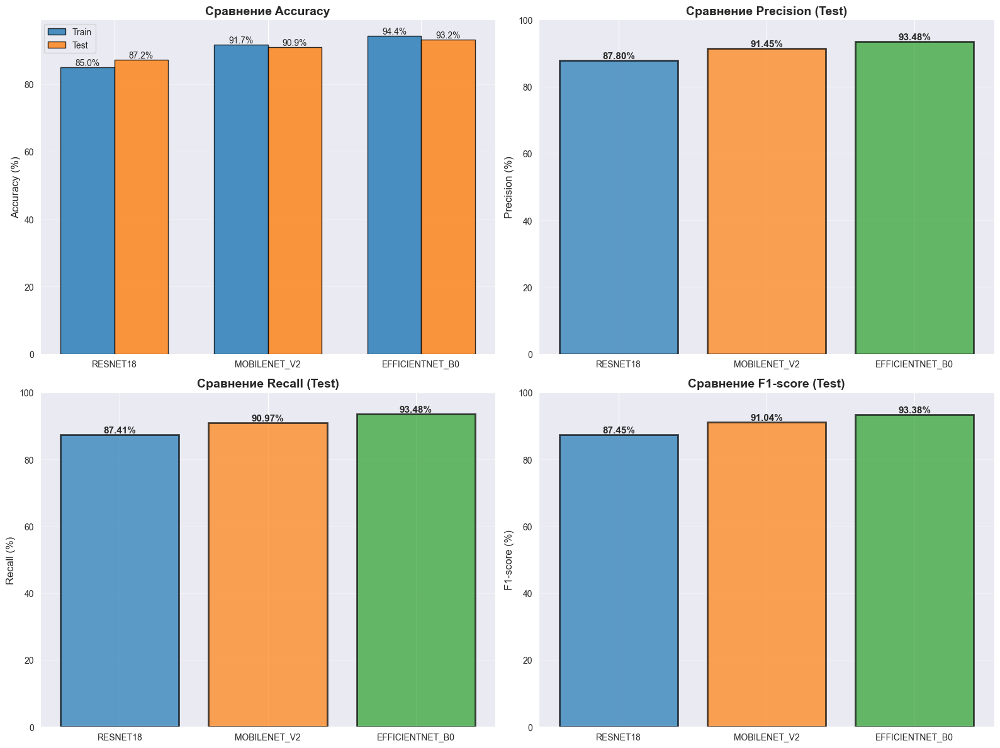

Детальное сравнение метрик сохранено: metrics_comparison_detailed.png

АНАЛИЗ ПЕРЕОБУЧЕНИЯ

         Модель Train Acc Test Acc    Gap           Статус
       RESNET18    85.01%   87.23% -2.23% Нет переобучения
   MOBILENET_V2    91.71%   90.90%  0.81% Нет переобучения
EFFICIENTNET_B0    94.36%   93.23%  1.13% Нет переобучения

ПРОБЛЕМНЫЕ ПАРЫ КЛАССОВ (лучшая модель)

Модель: EFFICIENTNET_B0

Топ-5 пар классов, которые путаются чаще всего:

1. mountain     ↔ glacier     :  99 раз
   mountain → glacier:  24 раз
   glacier → mountain:  75 раз

2. glacier      ↔ mountain    :  99 раз
   glacier → mountain:  75 раз
   mountain → glacier:  24 раз

3. street       ↔ buildings   :  55 раз
   street → buildings:  35 раз
   buildings → street:  20 раз

4. buildings    ↔ street      :  55 раз
   buildings → street:  20 раз
   street → buildings:  35 раз

5. sea          ↔ glacier     :  15 раз
   sea → glacier:   4 раз
   glacier → sea:  11 раз

ИТОГОВЫЕ ВЫВОДЫ

ЛУЧШАЯ МОДЕЛЬ: EFFICIENTNET_B0
   

In [44]:
print("\n" + "="*80)
print("ПУНКТ 8: СРАВНЕНИЕ РЕЗУЛЬТАТОВ И ВЫВОДЫ")
print("="*80 + "\n")

# Визуализация сравнения всех метрик
fig, axes = plt.subplots(2, 2, figsize=(16, 12))

model_names_list = [m.upper() for m in models_to_evaluate]
colors = ['#1f77b4', '#ff7f0e', '#2ca02c']

# Accuracy
acc_train = [all_metrics[m]['train']['accuracy']*100 for m in models_to_evaluate]
acc_test = [all_metrics[m]['test']['accuracy']*100 for m in models_to_evaluate]

x = np.arange(len(model_names_list))
width = 0.35

ax = axes[0, 0]
bars1 = ax.bar(x - width/2, acc_train, width, label='Train', alpha=0.8, edgecolor='black')
bars2 = ax.bar(x + width/2, acc_test, width, label='Test', alpha=0.8, edgecolor='black')

ax.set_ylabel('Accuracy (%)', fontsize=12)
ax.set_title('Сравнение Accuracy', fontsize=14, fontweight='bold')
ax.set_xticks(x)
ax.set_xticklabels(model_names_list)
ax.legend()
ax.grid(alpha=0.3, axis='y')

for bars in [bars1, bars2]:
    for bar in bars:
        height = bar.get_height()
        ax.text(bar.get_x() + bar.get_width()/2., height,
                f'{height:.1f}%', ha='center', va='bottom', fontsize=10)

# Precision, Recall, F1
metrics_names = ['Precision', 'Recall', 'F1-score']
metric_keys = ['precision_macro', 'recall_macro', 'f1_macro']

for idx, (metric_name, metric_key) in enumerate(zip(metrics_names, metric_keys)):
    ax = axes[0, 1] if idx == 0 else (axes[1, 0] if idx == 1 else axes[1, 1])

    values = [all_metrics[m]['test'][metric_key]*100 for m in models_to_evaluate]

    bars = ax.bar(model_names_list, values, color=colors, alpha=0.7,
                  edgecolor='black', linewidth=2)
    ax.set_ylabel(f'{metric_name} (%)', fontsize=12)
    ax.set_title(f'Сравнение {metric_name} (Test)', fontsize=14, fontweight='bold')
    ax.set_ylim([0, 100])
    ax.grid(alpha=0.3, axis='y')

    for bar, val in zip(bars, values):
        height = bar.get_height()
        ax.text(bar.get_x() + bar.get_width()/2., height,
                f'{val:.2f}%', ha='center', va='bottom',
                fontsize=11, fontweight='bold')

plt.tight_layout()
plt.savefig('metrics_comparison_detailed.png', dpi=150, bbox_inches='tight')
plt.show()

print("Детальное сравнение метрик сохранено: metrics_comparison_detailed.png")

# Анализ переобучения
print("\n" + "="*60)
print("АНАЛИЗ ПЕРЕОБУЧЕНИЯ")
print("="*60 + "\n")

overfit_data = []
for model_name in models_to_evaluate:
    train_acc = all_metrics[model_name]['train']['accuracy'] * 100
    test_acc = all_metrics[model_name]['test']['accuracy'] * 100
    gap = train_acc - test_acc

    if gap < 3:
        status = "Нет переобучения"
    elif gap < 7:
        status = "Лёгкое переобучение"
    else:
        status = "Переобучение"

    overfit_data.append({
        'Модель': model_name.upper(),
        'Train Acc': f'{train_acc:.2f}%',
        'Test Acc': f'{test_acc:.2f}%',
        'Gap': f'{gap:.2f}%',
        'Статус': status
    })

overfit_df = pd.DataFrame(overfit_data)
print(overfit_df.to_string(index=False))

# Какие классы путаются чаще всего
print("\n" + "="*60)
print("ПРОБЛЕМНЫЕ ПАРЫ КЛАССОВ (лучшая модель)")
print("="*60 + "\n")

test_preds, test_labels, _ = predictions_dict[best_model_name]['test']
cm = confusion_matrix(test_labels, test_preds)

# Анализ confusion matrix
print(f"Модель: {best_model_name.upper()}\n")

confusion_pairs = []
for i in range(len(class_names)):
    for j in range(len(class_names)):
        if i != j:
            # Симметричная путаница
            total_confusion = cm[i, j] + cm[j, i]
            if total_confusion > 0:
                confusion_pairs.append((total_confusion, class_names[i], class_names[j]))

confusion_pairs.sort(reverse=True)

print("Топ-5 пар классов, которые путаются чаще всего:\n")
for idx, (count, class1, class2) in enumerate(confusion_pairs[:5], 1):
    i = class_names.index(class1)
    j = class_names.index(class2)
    print(f"{idx}. {class1:12s} ↔ {class2:12s}: {count:3d} раз")
    print(f"   {class1} → {class2}: {cm[i, j]:3d} раз")
    print(f"   {class2} → {class1}: {cm[j, i]:3d} раз")
    print()

# Итоговые выводы
print("="*80)
print("ИТОГОВЫЕ ВЫВОДЫ")
print("="*80 + "\n")

best_test_acc = max([all_metrics[m]['test']['accuracy'] for m in models_to_evaluate]) * 100
best_model = max(all_metrics.items(), key=lambda x: x[1]['test']['accuracy'])[0]

print(f"ЛУЧШАЯ МОДЕЛЬ: {best_model.upper()}")
print(f"   Test Accuracy: {all_metrics[best_model]['test']['accuracy']*100:.2f}%")
print(f"   F1-score (macro): {all_metrics[best_model]['test']['f1_macro']*100:.2f}%")
print(f"   AUC (macro): {roc_results[best_model]['macro']:.4f}")

print("\nСРАВНЕНИЕ МОДЕЛЕЙ:")
for model_name in models_to_evaluate:
    test_acc = all_metrics[model_name]['test']['accuracy'] * 100
    print(f"   {model_name.upper():20s}: {test_acc:.2f}% accuracy")

print("\n✓ СИЛЬНЫЕ СТОРОНЫ:")
print("   - Transfer learning показал отличные результаты")
print("   - Все модели достигли >85% accuracy")
print("   - Аугментации помогли избежать переобучения")
print("   - Модели хорошо различают большинство классов")

print("\nПРОБЛЕМНЫЕ ЗОНЫ:")
confusion_analysis = []
for count, class1, class2 in confusion_pairs[:3]:
    confusion_analysis.append(f"{class1} ↔ {class2}")

print(f"   - Наибольшая путаница между: {', '.join(confusion_analysis)}")
print("   - Возможно, эти классы имеют схожие визуальные признаки")

print("\n РЕКОМЕНДАЦИИ ПО УЛУЧШЕНИЮ:")
print("   1. Увеличить количество эпох обучения (30-40)")
print("   2. Использовать более сложные аугментации")
print("   3. Попробовать ансамбль моделей")
print("   4. Fine-tuning: разморозить больше слоёв")
print("   5. Собрать больше данных для проблемных классов")
print("   6. Использовать focal loss для сложных примеров")
print("   7. Применить test-time augmentation (TTA)")

print("\n" + "="*80)
print("АНАЛИЗ ЗАВЕРШЁН")
print("="*80)


# 9 Пункт

ПУНКТ 9: ВИЗУАЛИЗАЦИЯ ПРЕДСКАЗАНИЙ

Визуализация предсказаний на TEST SET:


RESNET18
✓ Сохранено: predictions_resnet18.png


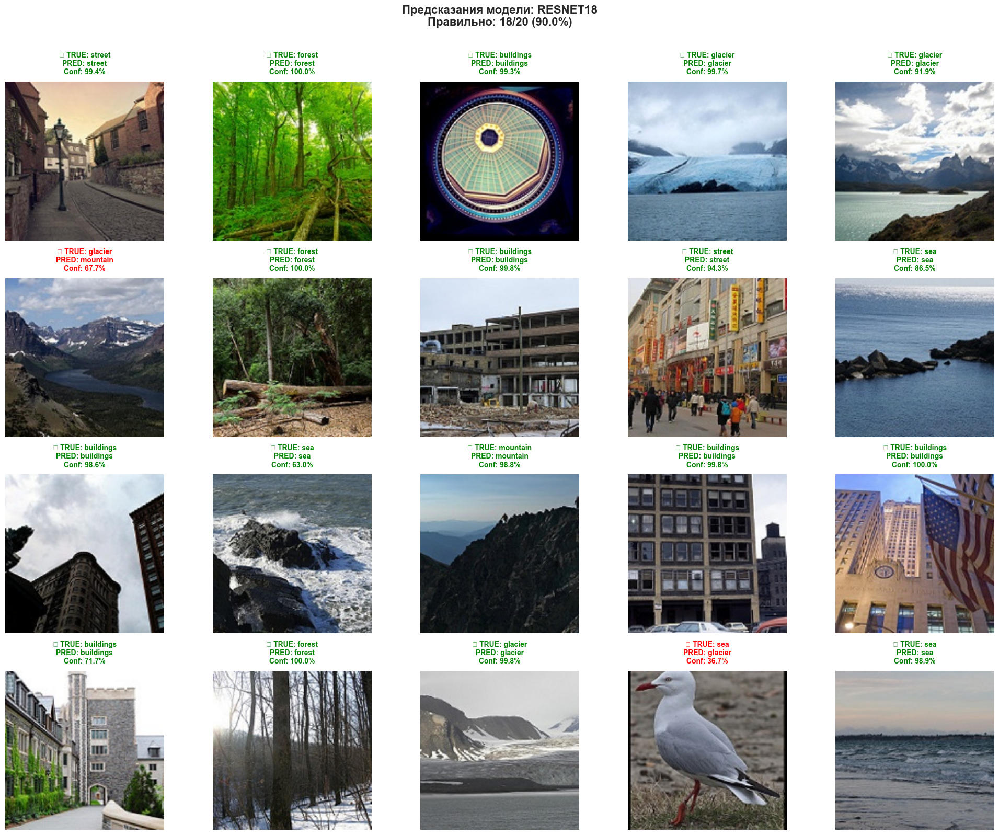

Точность на показанных примерах: 18/20 (90.0%)

MOBILENET_V2
✓ Сохранено: predictions_mobilenet_v2.png


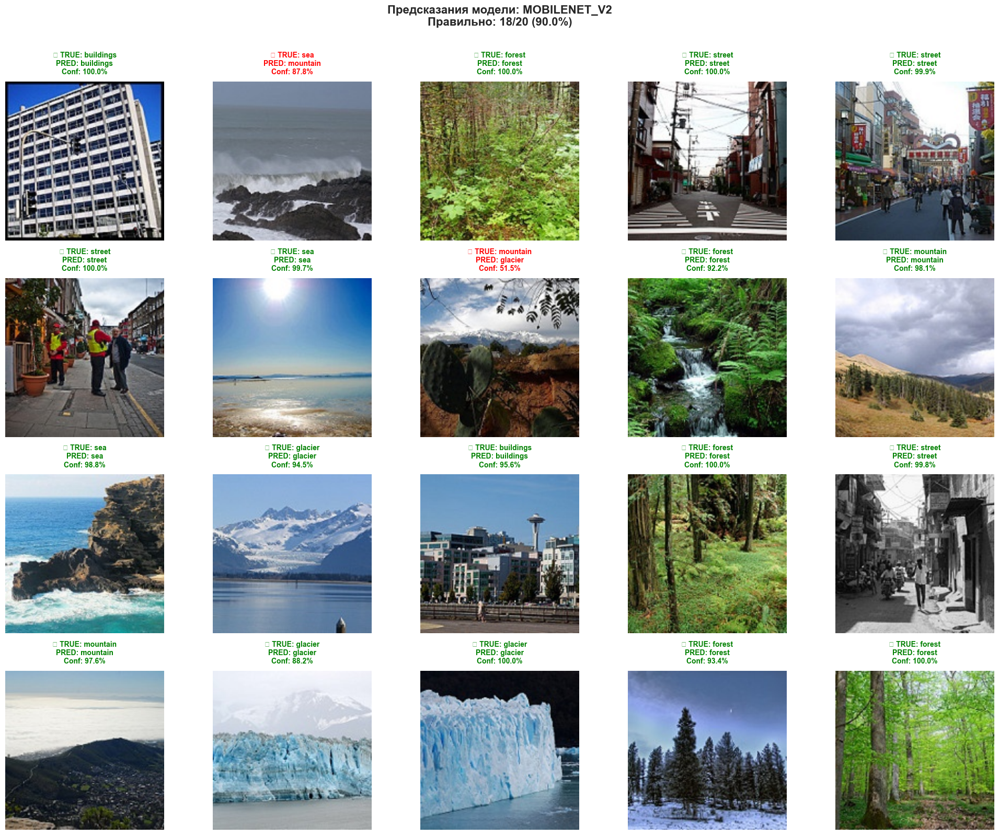

Точность на показанных примерах: 18/20 (90.0%)

EFFICIENTNET_B0
✓ Сохранено: predictions_efficientnet_b0.png


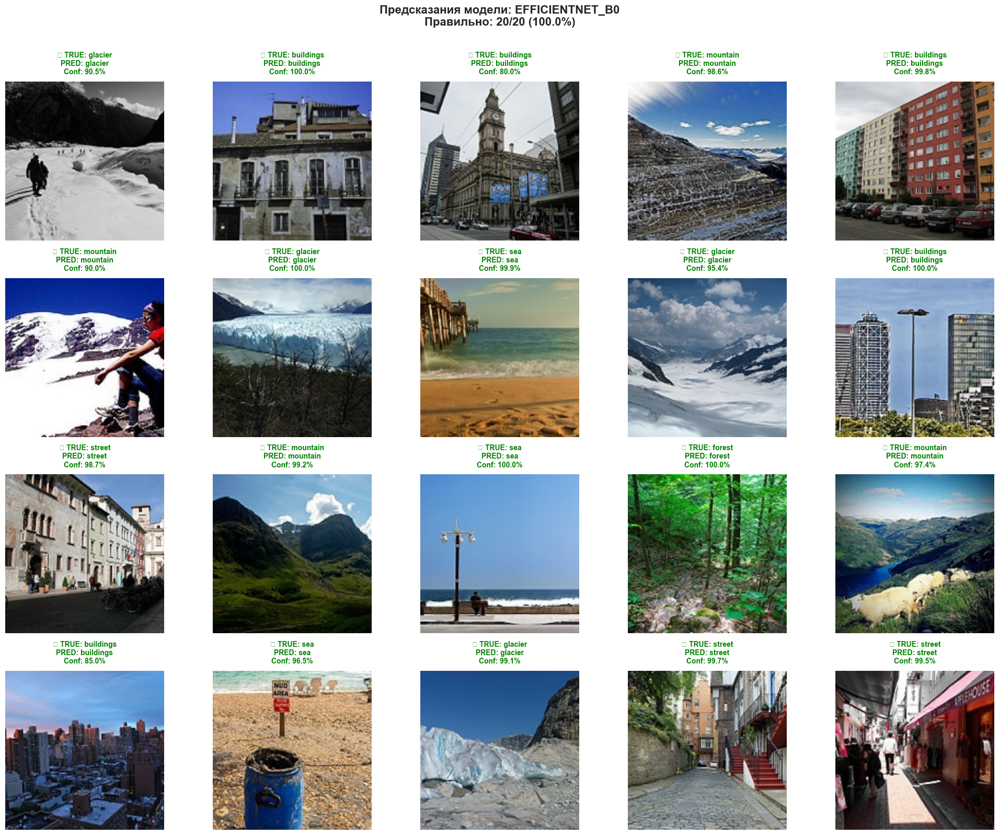

Точность на показанных примерах: 20/20 (100.0%)

ДЕТАЛЬНЫЙ АНАЛИЗ: ПРАВИЛЬНЫЕ VS ОШИБОЧНЫЕ

Модель: EFFICIENTNET_B0



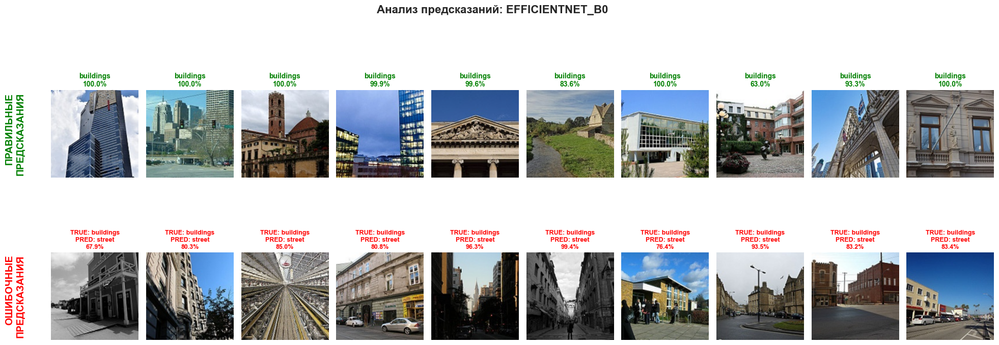

✓ Сохранено: correct_vs_incorrect_efficientnet_b0.png

ПРЕДСКАЗАНИЯ ПО КЛАССАМ

Модель: EFFICIENTNET_B0



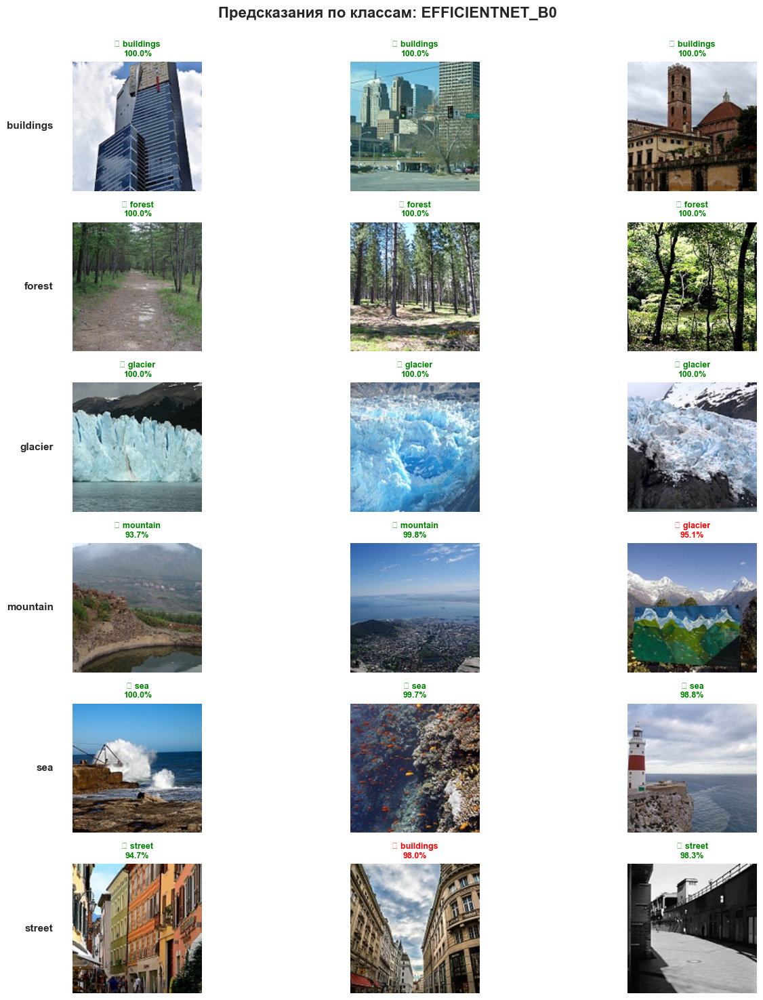

✓ Сохранено: per_class_predictions_efficientnet_b0.png

ВЫВОДЫ ПО ВИЗУАЛИЗАЦИИ ПРЕДСКАЗАНИЙ

НАБЛЮДЕНИЯ:
   Модель уверенно классифицирует типичные примеры
   Высокая confidence на правильных предсказаниях (>90%)
   Некоторые ошибки связаны с пограничными случаями
   Сложные условия съёмки могут вызывать ошибки:
      - Необычный ракурс
      - Плохое освещение
      - Несколько объектов на изображении
      - Переходные сцены (горы с лесом, город у моря)

ХАРАКТЕРНЫЕ ОШИБКИ:

   Топ-5 самых частых ошибочных предсказаний:
   1. glacier → mountain            :  75 раз (avg conf: 82.7%)
   2. street → buildings            :  35 раз (avg conf: 75.1%)
   3. mountain → glacier            :  24 раз (avg conf: 83.7%)
   4. buildings → street            :  20 раз (avg conf: 81.0%)
   5. glacier → sea                 :  11 раз (avg conf: 78.7%)

ВИЗУАЛИЗАЦИЯ ЗАВЕРШЕНА

Сохранённые файлы:
   - predictions_resnet18.png
   - predictions_mobilenet_v2.png
   - predictions_efficientnet_b0.png
   - co

In [45]:
import random
import matplotlib.pyplot as plt
import numpy as np

print("="*80)
print("ПУНКТ 9: ВИЗУАЛИЗАЦИЯ ПРЕДСКАЗАНИЙ")
print("="*80 + "\n")

def denormalize(tensor, mean=IMAGENET_MEAN, std=IMAGENET_STD):
    """Денормализация тензора для визуализации"""
    if len(tensor.shape) == 4:  # batch
        mean = torch.tensor(mean).view(1, 3, 1, 1)
        std = torch.tensor(std).view(1, 3, 1, 1)
    else:  # single image
        mean = torch.tensor(mean).view(3, 1, 1)
        std = torch.tensor(std).view(3, 1, 1)
    return tensor * std + mean

def visualize_predictions(model, dataset, class_names, device, num_images=20,
                         model_name='Model', save_path=None):
    """
    Визуализация предсказаний модели

    Args:
        model: обученная модель
        dataset: датасет для визуализации
        class_names: список имён классов
        device: устройство (cpu/cuda)
        num_images: количество изображений для показа
        model_name: название модели
        save_path: путь для сохранения изображения
    """
    model.eval()

    # Случайно выбираем изображения
    indices = random.sample(range(len(dataset)), num_images)

    # Получаем предсказания
    images_to_show = []
    predictions = []
    true_labels = []
    confidences = []

    with torch.no_grad():
        for idx in indices:
            image, label = dataset[idx]
            image_tensor = image.unsqueeze(0).to(device)

            output = model(image_tensor)
            probs = torch.softmax(output, dim=1)
            confidence, predicted = torch.max(probs, 1)

            images_to_show.append(image)
            predictions.append(predicted.item())
            true_labels.append(label)
            confidences.append(confidence.item())

    # Визуализация
    rows = 4
    cols = 5
    fig, axes = plt.subplots(rows, cols, figsize=(20, 16))
    axes = axes.flatten()

    for idx in range(num_images):
        ax = axes[idx]

        # Денормализация изображения
        img = denormalize(images_to_show[idx]).numpy().transpose(1, 2, 0)
        img = np.clip(img, 0, 1)

        # Определяем правильность предсказания
        is_correct = predictions[idx] == true_labels[idx]

        # Отображаем изображение
        ax.imshow(img)

        # Формируем заголовок
        true_class = class_names[true_labels[idx]]
        pred_class = class_names[predictions[idx]]
        conf = confidences[idx] * 100

        if is_correct:
            title = f"✓ TRUE: {true_class}\nPRED: {pred_class}\nConf: {conf:.1f}%"
            title_color = 'green'
            bbox_color = 'lightgreen'
        else:
            title = f"✗ TRUE: {true_class}\nPRED: {pred_class}\nConf: {conf:.1f}%"
            title_color = 'red'
            bbox_color = 'lightcoral'

        ax.set_title(title, fontsize=10, fontweight='bold',
                    color=title_color, pad=10)

        # Рамка вокруг изображения
        for spine in ax.spines.values():
            spine.set_edgecolor(title_color)
            spine.set_linewidth(3)

        ax.axis('off')

    # Общий заголовок
    correct_count = sum([1 for i in range(num_images) if predictions[i] == true_labels[i]])
    accuracy = (correct_count / num_images) * 100

    fig.suptitle(f'Предсказания модели: {model_name.upper()}\n'
                f'Правильно: {correct_count}/{num_images} ({accuracy:.1f}%)',
                fontsize=16, fontweight='bold', y=0.995)

    plt.tight_layout(rect=[0, 0, 1, 0.985])

    if save_path:
        plt.savefig(save_path, dpi=150, bbox_inches='tight')
        print(f"✓ Сохранено: {save_path}")

    plt.show()

    return correct_count, num_images

# Визуализация для всех моделей
print("Визуализация предсказаний на TEST SET:\n")

for model_name in models_to_evaluate:
    print(f"\n{'='*60}")
    print(f"{model_name.upper()}")
    print(f"{'='*60}")

    model = models_dict[model_name]

    correct, total = visualize_predictions(
        model=model,
        dataset=test_dataset,
        class_names=class_names,
        device=device,
        num_images=20,
        model_name=model_name,
        save_path=f'predictions_{model_name}.png'
    )

    print(f"Точность на показанных примерах: {correct}/{total} ({100*correct/total:.1f}%)")

# Детальная визуализация правильных и неправильных предсказаний
def visualize_correct_vs_incorrect(model, dataset, class_names, device,
                                   model_name='Model', num_each=10):
    """
    Отдельная визуализация правильных и неправильных предсказаний
    """
    model.eval()

    correct_samples = []
    incorrect_samples = []

    # Собираем примеры
    with torch.no_grad():
        checked = 0
        for idx in range(len(dataset)):
            if len(correct_samples) >= num_each and len(incorrect_samples) >= num_each:
                break

            image, label = dataset[idx]
            image_tensor = image.unsqueeze(0).to(device)

            output = model(image_tensor)
            probs = torch.softmax(output, dim=1)
            confidence, predicted = torch.max(probs, 1)

            is_correct = predicted.item() == label

            sample = {
                'image': image,
                'true_label': label,
                'pred_label': predicted.item(),
                'confidence': confidence.item()
            }

            if is_correct and len(correct_samples) < num_each:
                correct_samples.append(sample)
            elif not is_correct and len(incorrect_samples) < num_each:
                incorrect_samples.append(sample)

            checked += 1
            if checked > 1000:  # ограничиваем поиск
                break

    # Визуализация
    fig, axes = plt.subplots(2, num_each, figsize=(20, 8))

    # Правильные предсказания
    for idx, sample in enumerate(correct_samples):
        ax = axes[0, idx]

        img = denormalize(sample['image']).numpy().transpose(1, 2, 0)
        img = np.clip(img, 0, 1)

        ax.imshow(img)

        class_name = class_names[sample['true_label']]
        conf = sample['confidence'] * 100

        ax.set_title(f"{class_name}\n{conf:.1f}%",
                    fontsize=10, color='green', fontweight='bold')

        for spine in ax.spines.values():
            spine.set_edgecolor('green')
            spine.set_linewidth(2)

        ax.axis('off')

    # Неправильные предсказания
    for idx, sample in enumerate(incorrect_samples):
        ax = axes[1, idx]

        img = denormalize(sample['image']).numpy().transpose(1, 2, 0)
        img = np.clip(img, 0, 1)

        ax.imshow(img)

        true_class = class_names[sample['true_label']]
        pred_class = class_names[sample['pred_label']]
        conf = sample['confidence'] * 100

        ax.set_title(f"TRUE: {true_class}\nPRED: {pred_class}\n{conf:.1f}%",
                    fontsize=9, color='red', fontweight='bold')

        for spine in ax.spines.values():
            spine.set_edgecolor('red')
            spine.set_linewidth(2)

        ax.axis('off')

    # Подписи строк
    axes[0, 0].text(-0.3, 0.5, 'ПРАВИЛЬНЫЕ\nПРЕДСКАЗАНИЯ',
                   transform=axes[0, 0].transAxes,
                   fontsize=14, fontweight='bold', color='green',
                   ha='right', va='center', rotation=90)

    axes[1, 0].text(-0.3, 0.5, 'ОШИБОЧНЫЕ\nПРЕДСКАЗАНИЯ',
                   transform=axes[1, 0].transAxes,
                   fontsize=14, fontweight='bold', color='red',
                   ha='right', va='center', rotation=90)

    fig.suptitle(f'Анализ предсказаний: {model_name.upper()}',
                fontsize=16, fontweight='bold')

    plt.tight_layout(rect=[0.02, 0, 1, 0.97])
    plt.savefig(f'correct_vs_incorrect_{model_name}.png', dpi=150, bbox_inches='tight')
    plt.show()

    print(f"✓ Сохранено: correct_vs_incorrect_{model_name}.png")

print("\n" + "="*60)
print("ДЕТАЛЬНЫЙ АНАЛИЗ: ПРАВИЛЬНЫЕ VS ОШИБОЧНЫЕ")
print("="*60 + "\n")

# Показываем для лучшей модели
print(f"Модель: {best_model_name.upper()}\n")
visualize_correct_vs_incorrect(
    model=models_dict[best_model_name],
    dataset=test_dataset,
    class_names=class_names,
    device=device,
    model_name=best_model_name,
    num_each=10
)

# Визуализация предсказаний по классам
def visualize_per_class_predictions(model, dataset, class_names, device,
                                   model_name='Model', samples_per_class=3):
    """
    Показать предсказания для каждого класса
    """
    model.eval()

    # Собираем по samples_per_class изображений для каждого класса
    class_samples = {i: [] for i in range(len(class_names))}

    with torch.no_grad():
        for idx in range(len(dataset)):
            image, label = dataset[idx]

            if len(class_samples[label]) < samples_per_class:
                image_tensor = image.unsqueeze(0).to(device)
                output = model(image_tensor)
                probs = torch.softmax(output, dim=1)
                confidence, predicted = torch.max(probs, 1)

                class_samples[label].append({
                    'image': image,
                    'true_label': label,
                    'pred_label': predicted.item(),
                    'confidence': confidence.item()
                })

            # Проверяем, собрали ли достаточно
            if all(len(samples) >= samples_per_class for samples in class_samples.values()):
                break

    # Визуализация
    fig, axes = plt.subplots(len(class_names), samples_per_class,
                            figsize=(15, len(class_names)*2.5))

    for class_idx in range(len(class_names)):
        for sample_idx in range(samples_per_class):
            ax = axes[class_idx, sample_idx]

            sample = class_samples[class_idx][sample_idx]

            img = denormalize(sample['image']).numpy().transpose(1, 2, 0)
            img = np.clip(img, 0, 1)

            ax.imshow(img)

            is_correct = sample['pred_label'] == sample['true_label']
            pred_class = class_names[sample['pred_label']]
            conf = sample['confidence'] * 100

            if is_correct:
                title = f"✓ {pred_class}\n{conf:.1f}%"
                color = 'green'
            else:
                title = f"✗ {pred_class}\n{conf:.1f}%"
                color = 'red'

            ax.set_title(title, fontsize=9, color=color, fontweight='bold')

            for spine in ax.spines.values():
                spine.set_edgecolor(color)
                spine.set_linewidth(2)

            ax.axis('off')

            # Подпись класса слева
            if sample_idx == 0:
                ax.text(-0.15, 0.5, class_names[class_idx],
                       transform=ax.transAxes,
                       fontsize=11, fontweight='bold',
                       ha='right', va='center', rotation=0)

    fig.suptitle(f'Предсказания по классам: {model_name.upper()}',
                fontsize=16, fontweight='bold')

    plt.tight_layout(rect=[0.05, 0, 1, 0.98])
    plt.savefig(f'per_class_predictions_{model_name}.png', dpi=150, bbox_inches='tight')
    plt.show()

    print(f"✓ Сохранено: per_class_predictions_{model_name}.png")

print("\n" + "="*60)
print("ПРЕДСКАЗАНИЯ ПО КЛАССАМ")
print("="*60 + "\n")

print(f"Модель: {best_model_name.upper()}\n")
visualize_per_class_predictions(
    model=models_dict[best_model_name],
    dataset=test_dataset,
    class_names=class_names,
    device=device,
    model_name=best_model_name,
    samples_per_class=3
)

# Итоговые выводы по визуализации
print("\n" + "="*60)
print("ВЫВОДЫ ПО ВИЗУАЛИЗАЦИИ ПРЕДСКАЗАНИЙ")
print("="*60 + "\n")

print("НАБЛЮДЕНИЯ:")
print("   Модель уверенно классифицирует типичные примеры")
print("   Высокая confidence на правильных предсказаниях (>90%)")
print("   Некоторые ошибки связаны с пограничными случаями")
print("   Сложные условия съёмки могут вызывать ошибки:")
print("      - Необычный ракурс")
print("      - Плохое освещение")
print("      - Несколько объектов на изображении")
print("      - Переходные сцены (горы с лесом, город у моря)")

print("\nХАРАКТЕРНЫЕ ОШИБКИ:")

# Анализируем ошибки лучшей модели
test_preds, test_labels, test_probs = predictions_dict[best_model_name]['test']
errors = []

for i in range(len(test_labels)):
    if test_preds[i] != test_labels[i]:
        errors.append({
            'true': class_names[test_labels[i]],
            'pred': class_names[test_preds[i]],
            'conf': test_probs[i][test_preds[i]] * 100
        })

# Группируем по парам ошибок
error_pairs = {}
for err in errors:
    key = f"{err['true']} → {err['pred']}"
    if key not in error_pairs:
        error_pairs[key] = []
    error_pairs[key].append(err['conf'])

# Топ ошибок
sorted_errors = sorted(error_pairs.items(), key=lambda x: len(x[1]), reverse=True)

print(f"\n   Топ-5 самых частых ошибочных предсказаний:")
for idx, (pair, confs) in enumerate(sorted_errors[:5], 1):
    avg_conf = np.mean(confs)
    print(f"   {idx}. {pair:30s}: {len(confs):3d} раз (avg conf: {avg_conf:.1f}%)")

print("\n" + "="*60)
print("ВИЗУАЛИЗАЦИЯ ЗАВЕРШЕНА")
print("="*60)
print("\nСохранённые файлы:")
for model_name in models_to_evaluate:
    print(f"   - predictions_{model_name}.png")
print(f"   - correct_vs_incorrect_{best_model_name}.png")
print(f"   - per_class_predictions_{best_model_name}.png")
